In [1]:
from google.colab import drive

drive.mount('/content/drive/')

Mounted at /content/drive/


#Importing the dataset

In this section we will load the extracted features from RING for each pdb_id and load it into a dataframe, together with the corresponding class label for each protein.

In [2]:
import os
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB, MultinomialNB, CategoricalNB, ComplementNB, BernoulliNB

# data manipulation
import pandas as pd
import numpy as np

# data viz
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns

# apply some cool styling
plt.style.use("ggplot")
rcParams['figure.figsize'] = (12, 6)

In [3]:
path = 'drive/MyDrive/UniPD/SB_Project/contacts_classification'

In [ ]:
# Combine all PDBs into a single dataframe
dfs = []
for filename in os.listdir(path + '/features_ring'):
    dfs.append(pd.read_csv(path + '/features_ring/' + str(filename), sep='\t'))
df = pd.concat(dfs)
df

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_down,t_phi,t_psi,t_ss3,t_a1,t_a2,t_a3,t_a4,t_a5,Interaction
0,6iyg,A,246,,S,H,0.000,26.0,18.0,-0.994,...,20.0,0.914,0.757,L,1.831,-0.561,0.533,-0.277,1.648,HBOND
1,6iyg,A,247,,D,H,0.448,7.0,22.0,-0.973,...,20.0,0.914,0.757,L,1.831,-0.561,0.533,-0.277,1.648,NaN
2,6iyg,A,136,,W,B,0.013,15.0,22.0,-2.153,...,8.0,-1.199,-0.375,H,1.050,0.302,-3.656,-0.259,-3.242,HBOND
3,6iyg,A,9,,G,-,0.250,7.0,20.0,1.422,...,20.0,0.914,0.757,L,1.831,-0.561,0.533,-0.277,1.648,NaN
4,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,15.0,-1.381,-0.597,H,0.931,-0.179,-3.005,-0.503,-1.853,HBOND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127,6j2m,A,391,,T,E,0.352,4.0,23.0,-1.506,...,14.0,-2.565,2.755,H,-1.006,-0.590,1.891,-0.397,0.412,NaN
128,6j2m,A,388,,P,T,0.647,6.0,17.0,-0.900,...,13.0,-1.156,2.317,H,-1.019,-0.987,-1.505,1.266,-0.912,NaN
129,6j2m,A,427,,K,H,0.644,10.0,17.0,-1.034,...,13.0,-1.839,0.155,H,-0.663,-1.524,2.219,-1.005,1.212,HBOND
130,6j2m,A,427,,K,H,0.644,10.0,17.0,-1.034,...,13.0,-1.839,0.155,H,-0.663,-1.524,2.219,-1.005,1.212,VDW


If we want to use the clean version of the dataset with the additional features we added regarding distance, aromaticity and isoelectric point, it should be loaded with the following code:

In [4]:
df = pd.read_csv(path + "/clean_additional_features_dataset.csv")
df = df.drop("Unnamed: 0", axis=1)

In [5]:
df

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_a4,t_a5,Distance,s_residue_hydrophobicity,t_residue_hydrophobicity,s_residue_isoelectric_point,t_residue_isoelectric_point,s_residue_aromatic,t_residue_aromatic,Interaction
0,6iyg,A,246,,S,H,0.000,26.0,18.0,-0.994,...,-0.277,1.648,5.502789,-0.8,-3.9,5.240009,8.750052,False,False,HBOND
1,6iyg,A,136,,W,B,0.013,15.0,22.0,-2.153,...,-0.259,-3.242,6.184382,-0.9,-3.5,5.525000,4.299381,True,False,HBOND
2,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,-0.503,-1.853,10.881779,-3.9,-3.5,8.750052,5.525000,False,False,HBOND
3,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,-0.503,-1.853,8.005460,-3.9,-3.5,8.750052,5.525000,False,False,VDW
4,6iyg,A,49,,D,T,0.080,20.0,11.0,-1.293,...,-0.838,1.512,7.902977,-3.5,-1.3,4.299381,5.524318,False,True,HBOND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
451867,6j2m,A,428,,G,H,0.000,20.0,13.0,-1.049,...,1.045,2.064,7.908767,-0.4,-0.4,5.525000,5.525000,False,False,HBOND
451868,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,-0.397,0.412,5.203335,4.2,2.8,5.494989,5.525000,False,True,HBOND
451869,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,-0.397,0.412,5.330440,4.2,2.8,5.494989,5.525000,False,True,VDW
451870,6j2m,A,427,,K,H,0.644,10.0,17.0,-1.034,...,-1.005,1.212,5.946533,-3.9,1.9,8.750052,5.275022,False,False,HBOND


Here we remove the rows with missing value in at least one column.

In [6]:
# Remove all rows with NaN in at least one column
# including rows with missing class (they could be false negatives)
df.dropna(inplace=True)

# Define ground truth values
y = df['Interaction'].astype('category')
y

0         HBOND
1         HBOND
2         HBOND
3           VDW
4         HBOND
          ...  
451867    HBOND
451868    HBOND
451869      VDW
451870    HBOND
451871      VDW
Name: Interaction, Length: 451872, dtype: category
Categories (6, object): ['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']

# Exploratory data analysis

In this section we start with a detailed Exploratory Data Analysis of our dataset, such that all missing values have been excluded. In this way we carry on for the initial analysis and models for the dataset. We will later decide if missing values would somehow be filled.

In [ ]:
df

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_down,t_phi,t_psi,t_ss3,t_a1,t_a2,t_a3,t_a4,t_a5,Interaction
0,6iyg,A,246,,S,H,0.000,26.0,18.0,-0.994,...,20.0,0.914,0.757,L,1.831,-0.561,0.533,-0.277,1.648,HBOND
2,6iyg,A,136,,W,B,0.013,15.0,22.0,-2.153,...,8.0,-1.199,-0.375,H,1.050,0.302,-3.656,-0.259,-3.242,HBOND
4,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,15.0,-1.381,-0.597,H,0.931,-0.179,-3.005,-0.503,-1.853,HBOND
5,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,15.0,-1.381,-0.597,H,0.931,-0.179,-3.005,-0.503,-1.853,VDW
6,6iyg,A,49,,D,T,0.080,20.0,11.0,-1.293,...,14.0,-2.142,-0.184,H,0.260,0.830,3.097,-0.838,1.512,HBOND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122,6j2m,A,428,,G,H,0.000,20.0,13.0,-1.049,...,13.0,-1.254,-0.594,H,-0.384,1.652,1.330,1.045,2.064,HBOND
123,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,14.0,-2.565,2.755,H,-1.006,-0.590,1.891,-0.397,0.412,HBOND
124,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,14.0,-2.565,2.755,H,-1.006,-0.590,1.891,-0.397,0.412,VDW
129,6j2m,A,427,,K,H,0.644,10.0,17.0,-1.034,...,13.0,-1.839,0.155,H,-0.663,-1.524,2.219,-1.005,1.212,HBOND


The dataset with additional features:

In [ ]:
df

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_a4,t_a5,Distance,s_residue_hydrophobicity,t_residue_hydrophobicity,s_residue_isoelectric_point,t_residue_isoelectric_point,s_residue_aromatic,t_residue_aromatic,Interaction
0,6iyg,A,246,,S,H,0.000,26.0,18.0,-0.994,...,-0.277,1.648,5.502789,-0.8,-3.9,5.240009,8.750052,False,False,HBOND
1,6iyg,A,136,,W,B,0.013,15.0,22.0,-2.153,...,-0.259,-3.242,6.184382,-0.9,-3.5,5.525000,4.299381,True,False,HBOND
2,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,-0.503,-1.853,10.881779,-3.9,-3.5,8.750052,5.525000,False,False,HBOND
3,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,-0.503,-1.853,8.005460,-3.9,-3.5,8.750052,5.525000,False,False,VDW
4,6iyg,A,49,,D,T,0.080,20.0,11.0,-1.293,...,-0.838,1.512,7.902977,-3.5,-1.3,4.299381,5.524318,False,True,HBOND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
451867,6j2m,A,428,,G,H,0.000,20.0,13.0,-1.049,...,1.045,2.064,7.908767,-0.4,-0.4,5.525000,5.525000,False,False,HBOND
451868,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,-0.397,0.412,5.203335,4.2,2.8,5.494989,5.525000,False,True,HBOND
451869,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,-0.397,0.412,5.330440,4.2,2.8,5.494989,5.525000,False,True,VDW
451870,6j2m,A,427,,K,H,0.644,10.0,17.0,-1.034,...,-1.005,1.212,5.946533,-3.9,1.9,8.750052,5.275022,False,False,HBOND


The basic statistics show that our data is contained of 32 features (without pdb_id and interaction class) in total:


*   First 4 are connected to Source residue identifier (Chain, Index, Insertion code and Name
*   Next 12 are the source residue features (DSSP, rsa, half sphere exposure up and down, phi and psi angles, SS 3 states (from angles and 5 atchley features)
* Next 4 and 12 are accordingly the same features but for the target residue.



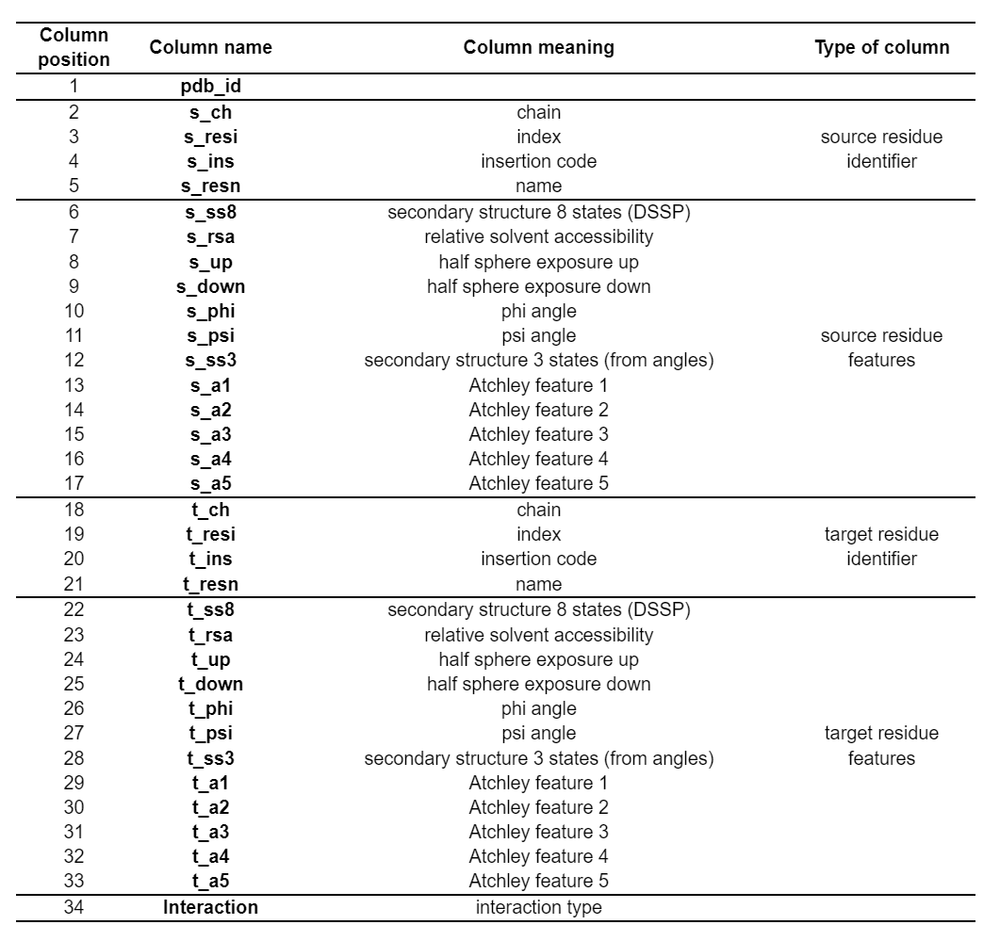

The Atchley features consist of five numerical attributes that characterize protein sequences:

* First Atchley Factor (FAA): Measures the overall hydrophobicity of
the amino acid sequence.

* Second Atchley Factor (FAC): Reflects the electron-ion interaction potential of the amino acid sequence.

* Third Atchley Factor (FAD): Describes the steric parameters of the amino acid sequence.

* Fourth Atchley Factor (FAE): Captures the electronic polarizability of the amino acid sequence.

* Fifth Atchley Factor (FAF): Represents the secondary structure factor, indicating the likelihood of specific secondary structures.

Here we display the statistics for the numerical features, (which are 10 for source 10 for target), without the residue identifier ones, first for the source and then for target residue features:

In [ ]:
df.describe().iloc[:, 1:11]

,s_rsa,s_up,s_down,s_phi,s_psi,s_a1,s_a2,s_a3,s_a4,s_a5
count,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000
mean,0.188116,15.453908,17.050265,-1.366207,0.457975,0.008609,-0.109707,-0.039694,0.226117,-0.087530
std,0.207392,7.048051,5.461803,0.716709,1.540880,1.008144,0.939297,2.158792,0.905792,1.603459
min,0.000000,0.000000,2.000000,-3.141000,-3.141000,-1.343000,-1.524000,-4.760000,-2.128000,-3.242000
25%,0.009000,10.000000,13.000000,-1.778000,-0.744000,-1.006000,-0.987000,-1.505000,-0.397000,-1.262000
50%,0.106000,16.000000,17.000000,-1.182000,-0.521000,-0.228000,-0.279000,0.533000,0.393000,-0.146000
75%,0.324000,21.000000,21.000000,-1.070000,2.228000,0.945000,0.326000,1.502000,1.045000,1.313000
max,1.000000,45.000000,46.000000,3.141000,3.141000,1.831000,2.081000,3.097000,1.570000,2.897000


In [ ]:
df.describe().iloc[:, 12:]

,t_rsa,t_up,t_down,t_phi,t_psi,t_a1,t_a2,t_a3,t_a4,t_a5
count,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000,454193.000000
mean,0.202878,15.785393,16.111994,-1.338489,0.437073,0.014565,-0.176845,0.057004,0.226516,0.030402
std,0.218879,6.662187,5.774250,0.771608,1.471111,1.031736,0.900171,2.093689,0.919315,1.576308
min,0.000000,0.000000,0.000000,-3.141000,-3.142000,-1.343000,-1.524000,-4.760000,-2.128000,-3.242000
25%,0.012000,11.000000,12.000000,-1.767000,-0.729000,-1.006000,-0.987000,-1.505000,-0.397000,-0.912000
50%,0.122000,16.000000,16.000000,-1.207000,-0.390000,-0.228000,-0.279000,0.533000,0.393000,-0.146000
75%,0.345000,21.000000,20.000000,-1.079000,2.198000,0.945000,0.326000,1.502000,1.045000,1.313000
max,1.000000,47.000000,50.000000,3.140000,3.142000,1.831000,2.081000,3.097000,1.570000,2.897000


For the additional features dataset:

In [ ]:
df.describe().iloc[:, 22:]

,Distance,s_residue_hydrophobicity,t_residue_hydrophobicity,s_residue_isoelectric_point,t_residue_isoelectric_point
count,451872.000000,451872.000000,451872.000000,451872.000000,451872.000000
mean,6.661815,-0.286122,-0.262548,5.784658,5.865253
std,1.701387,3.096772,3.142315,1.267263,1.333123
min,3.895788,-4.500000,-4.500000,4.299381,4.299381
25%,5.444411,-3.500000,-3.500000,5.494989,5.494989
50%,6.121820,-0.800000,-0.800000,5.525000,5.525000
75%,7.527937,2.800000,2.800000,5.525000,5.525000
max,13.189383,4.500000,4.500000,9.750021,9.750021


Also we print the statistics for categorical features, and we observe DSSP features have 8 possible values whereas the feature regarding the 3 states of the angle have 3 as expected.

In [ ]:
df[["s_ss8", "s_ss3", "t_ss8", "t_ss3"]].describe()

,s_ss8,s_ss3,t_ss8,t_ss3
count,454193,454193,454193,454193
unique,8,2,8,2
top,H,H,H,H
freq,214096,439703,210785,433202


In [ ]:
print("Unique values for s_ss8: ", set(df.s_ss8.values))
print("Value counts: ", df.s_ss8.value_counts())
print()
print("Unique values for s_ss3: ", set(df.s_ss3.values))
print("Value counts: ", df.s_ss3.value_counts())
print()
print("Unique values for t_ss8: ", set(df.t_ss8.values))
print("Value counts: ", df.t_ss8.value_counts())
print()
print("Unique values for t_ss3: ", set(df.t_ss3.values))
print("Value counts: ", df.t_ss3.value_counts())



Unique values for s_ss8:  {'B', 'E', 'H', 'I', 'T', 'S', '-', 'G'}
Value counts:  H    214096
E     95628
-     72837
S     25231
T     23042
G     15500
B      5125
I      2734
Name: s_ss8, dtype: int64

Unique values for s_ss3:  {'L', 'H'}
Value counts:  H    439703
L     14490
Name: s_ss3, dtype: int64

Unique values for t_ss8:  {'B', 'E', 'H', 'I', 'T', 'S', '-', 'G'}
Value counts:  H    210785
E     92717
-     59664
T     38209
S     27446
G     16576
B      5045
I      3751
Name: t_ss8, dtype: int64

Unique values for t_ss3:  {'L', 'H'}
Value counts:  H    433202
L     20991
Name: t_ss3, dtype: int64


We see values of H are twice or three times more frequent than L values for s_ss3 and t_ss3 feature.

Regarding s_ss8 feature, values of 'H' are again most frequent both in source and target residues. Other values have pretty much the same distribution in source and target residues, with the only difference that in source residues, there are more values 'S' than 'T'.

We check for possible duplicated rows:

In [ ]:
#Find the duplicates

df.duplicated().sum()

0

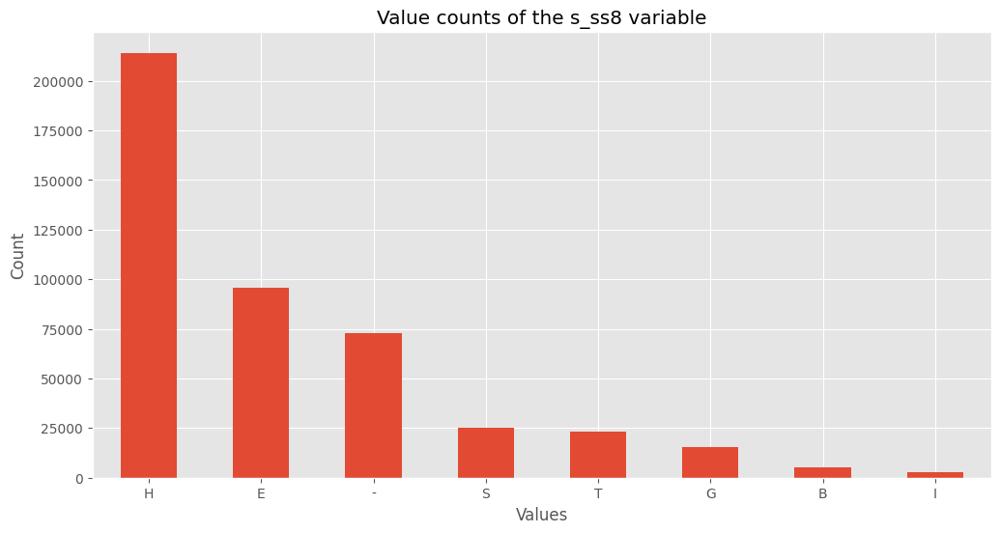

In [ ]:
df.s_ss8.value_counts().plot(kind="bar")
plt.title("Value counts of the s_ss8 variable")
plt.xlabel("Values")
plt.xticks(rotation=0)
plt.ylabel("Count")
plt.show()

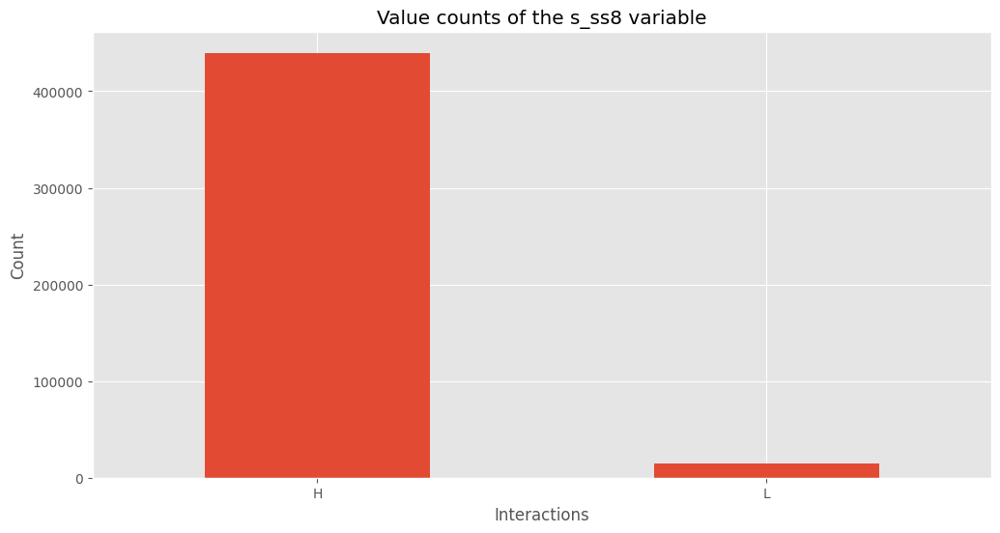

In [ ]:
df.s_ss3.value_counts().plot(kind="bar")
plt.title("Value counts of the s_ss8 variable")
plt.xlabel("Interactions")
plt.xticks(rotation=0)
plt.ylabel("Count")
plt.show()

Let us also inspect the target class distribution. As we may see we are abundant of contacts classified as HBOND, which is of course expected since most of the bonds in a protein are covalent hydrogen bonds.

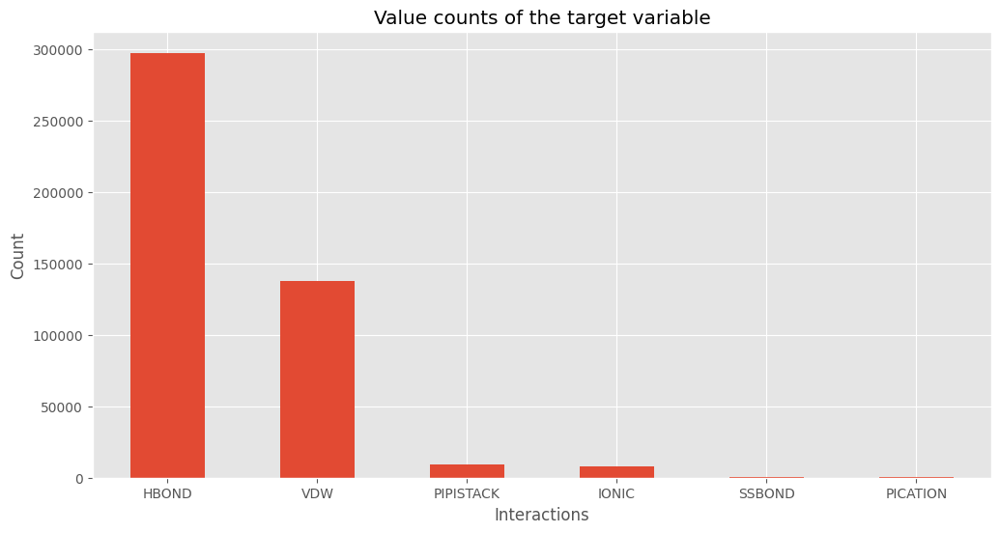

In [ ]:
df.Interaction.value_counts().plot(kind="bar")
plt.title("Value counts of the target variable")
plt.xlabel("Interactions")
plt.xticks(rotation=0)
plt.ylabel("Count")
plt.show()

By plotting a pairplot for all pairs of numerical features and the target variable in the dataset, we may inspect the possible linear correlations between variables as well as take a look at the histogram distributions of each variable separately.

In [ ]:
df.columns

Index(['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 's_ss8', 's_rsa', 's_up',
       's_down', 's_phi', 's_psi', 's_ss3', 's_a1', 's_a2', 's_a3', 's_a4',
       's_a5', 't_ch', 't_resi', 't_ins', 't_resn', 't_ss8', 't_rsa', 't_up',
       't_down', 't_phi', 't_psi', 't_ss3', 't_a1', 't_a2', 't_a3', 't_a4',
       't_a5', 'Interaction'],
      dtype='object')

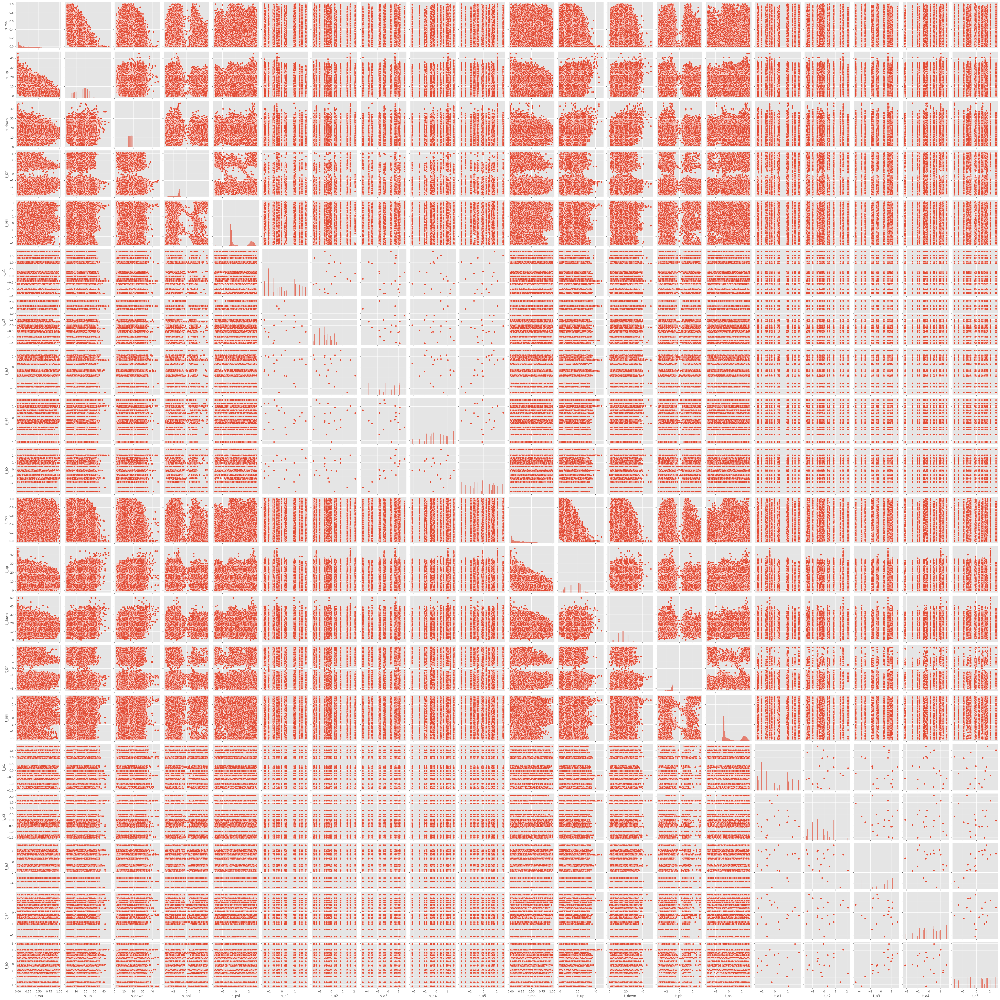

In [ ]:
sns.pairplot(df.drop(['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 't_ch', 't_resi', 't_ins', 't_resn', 's_ss3', 't_ss3', 's_ss8', 't_ss8' ], axis=1))

In [ ]:
plt.savefig(path + '/pairplot_all_numerical_variables.png')

<Figure size 1200x600 with 0 Axes>

From this plot we may observe some correlations between features s_a1 and s_a5, as well as between s_up and s_rsa.

It may also be observed that the psi angle feature has bimodal distribution.

Since we observe similar distribution between source and target residue features, on the next plot we will only plot the numerical features for the source residue to obtain more clear plot.

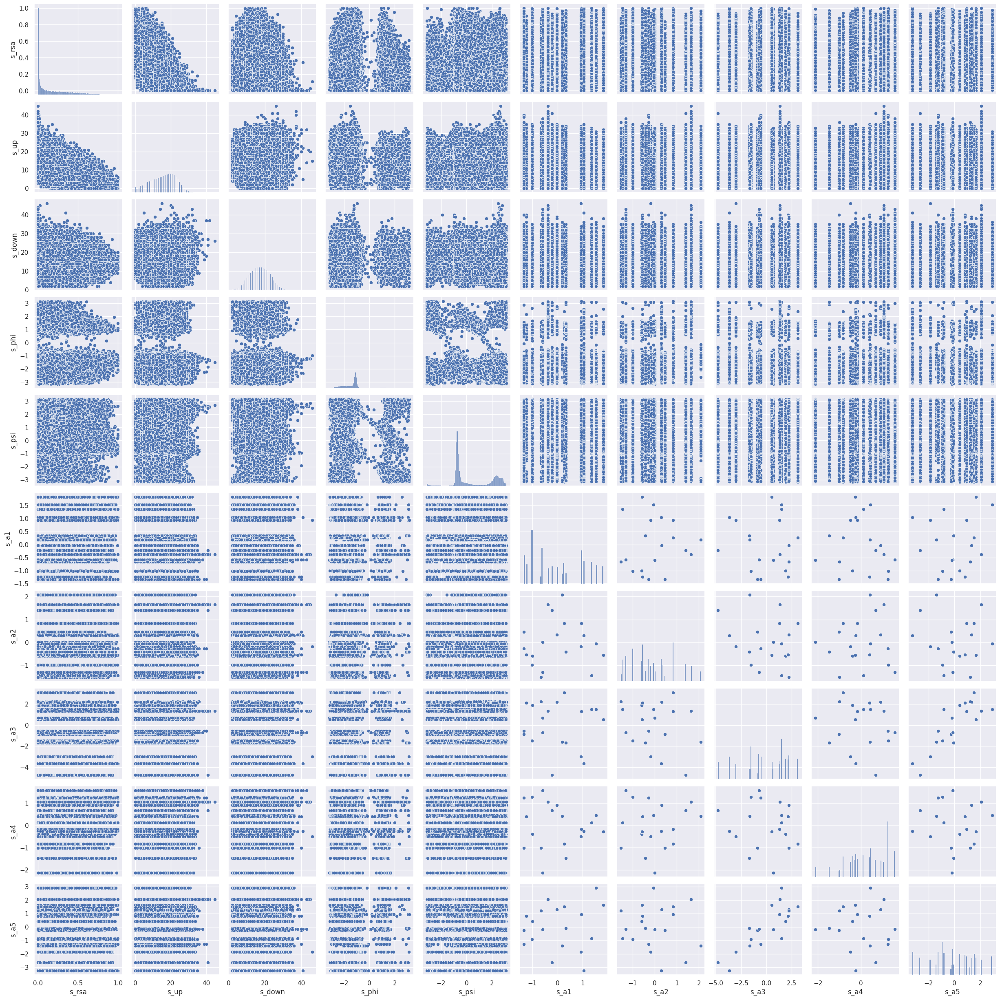

In [ ]:
sns.set()
sns_plot = sns.pairplot(df.drop(['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 's_ss3', 's_ss8', 't_ch', 't_resi', 't_ins', 't_resn', 't_ss8', 't_rsa', 't_up',
       't_down', 't_phi', 't_psi', 't_ss3', 't_a1', 't_a2', 't_a3', 't_a4',
       't_a5' ], axis=1), height=2.5)

sns_plot.figure.savefig(path + "/pairplot_all_source_numerical_variables.png")

And a pairplot graph for the dataset with additional features:

<__array_function__ internals>:180: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:180: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


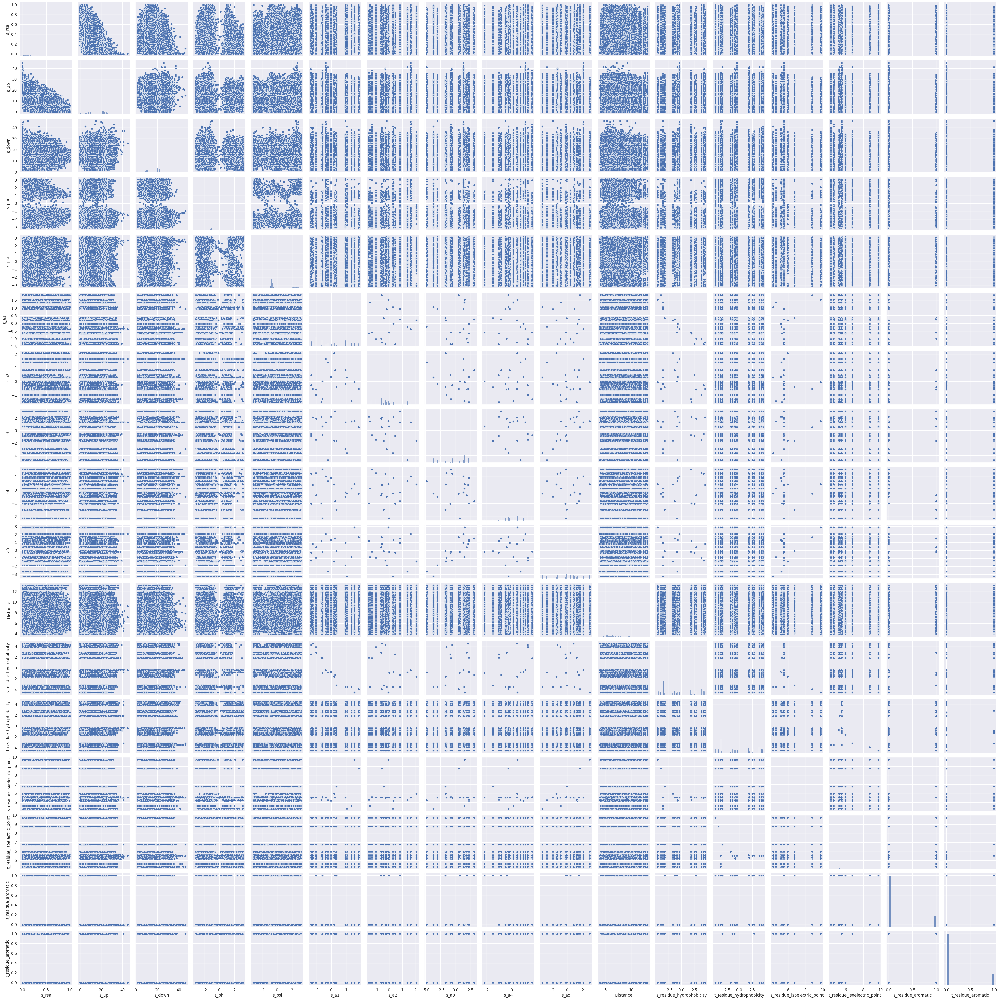

In [ ]:
sns.set()
sns_plot = sns.pairplot(df.drop(['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 's_ss3', 's_ss8', 't_ch', 't_resi', 't_ins', 't_resn', 't_ss8', 't_rsa', 't_up',
       't_down', 't_phi', 't_psi', 't_ss3', 't_a1', 't_a2', 't_a3', 't_a4',
       't_a5' ], axis=1), height=2.5)

sns_plot.figure.savefig(path + "/pairplot_all_source_numerical_variables_additional_features.png")

In [ ]:
sns_plot

Next we plot boxplots between numeric and target variables:

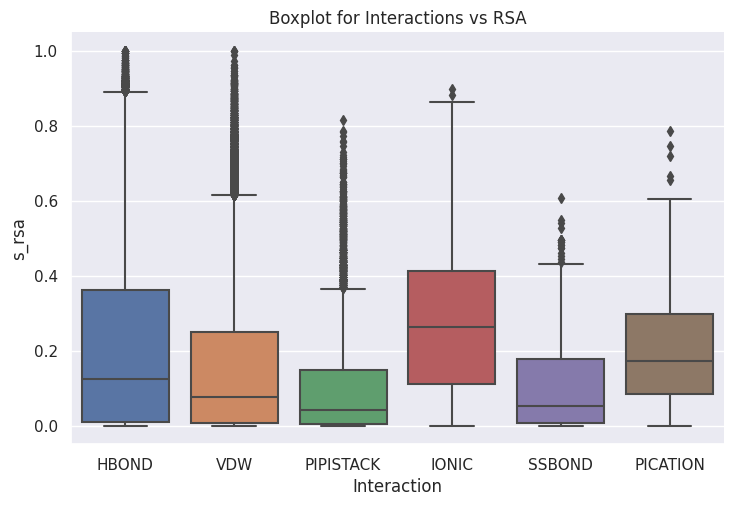

In [ ]:
sns.catplot(x="Interaction", y="s_rsa", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs RSA")
plt.show()

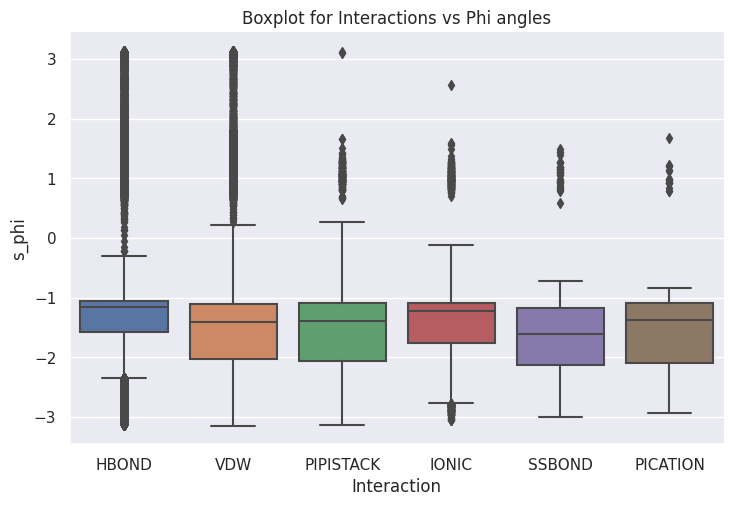

In [ ]:
sns.catplot(x="Interaction", y="s_phi", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Phi angles")  # C-alpha - N
plt.show()

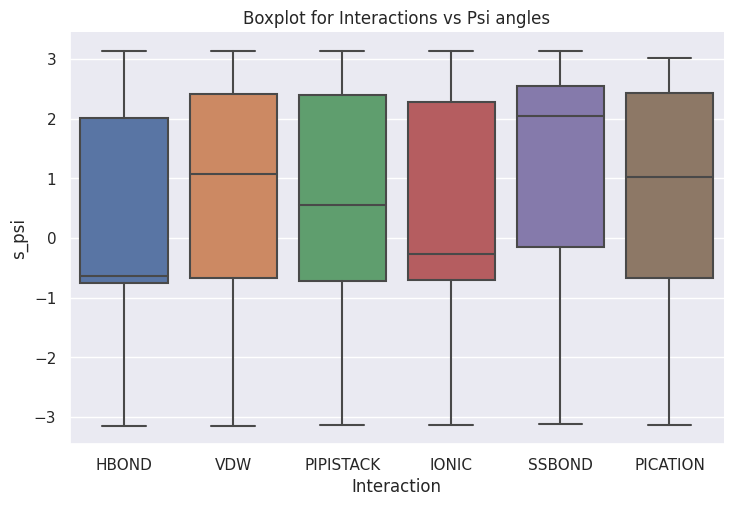

In [ ]:
sns.catplot(x="Interaction", y="s_psi", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Psi angles")  # C=O-N
plt.show()

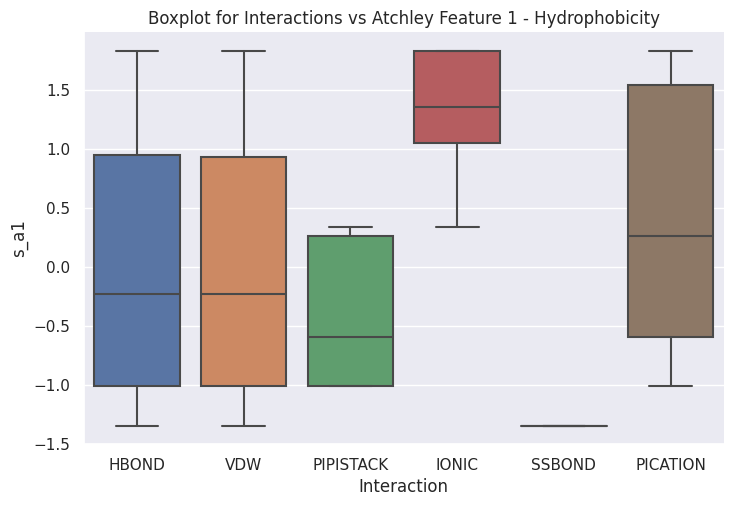

In [ ]:
sns.catplot(x="Interaction", y="s_a1", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Atchley Feature 1 - Hydrophobicity")
plt.show()

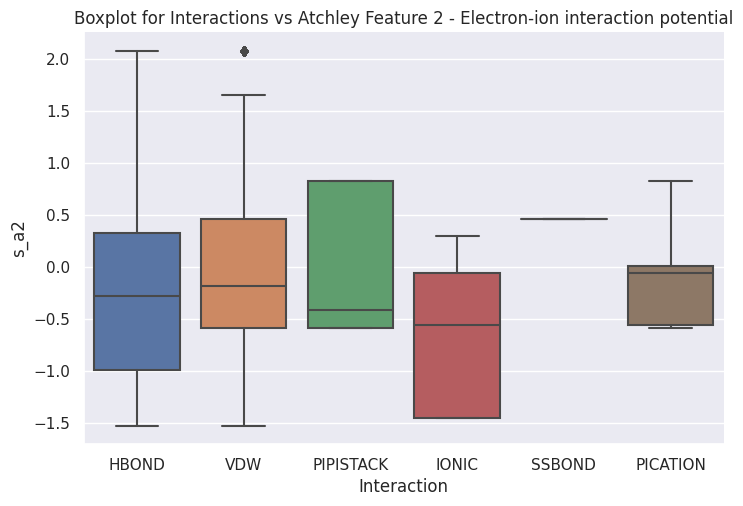

In [ ]:
sns.catplot(x="Interaction", y="s_a2", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Atchley Feature 2 - Electron-ion interaction potential")
plt.show()

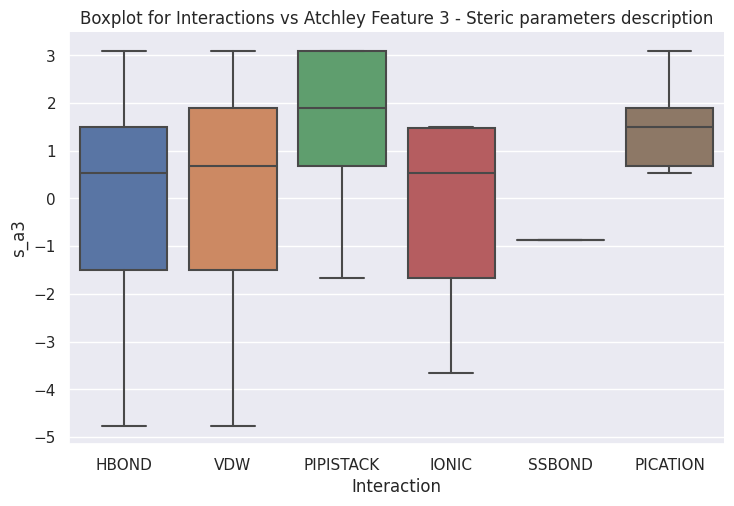

In [ ]:
sns.catplot(x="Interaction", y="s_a3", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Atchley Feature 3 - Steric parameters description")
plt.show()

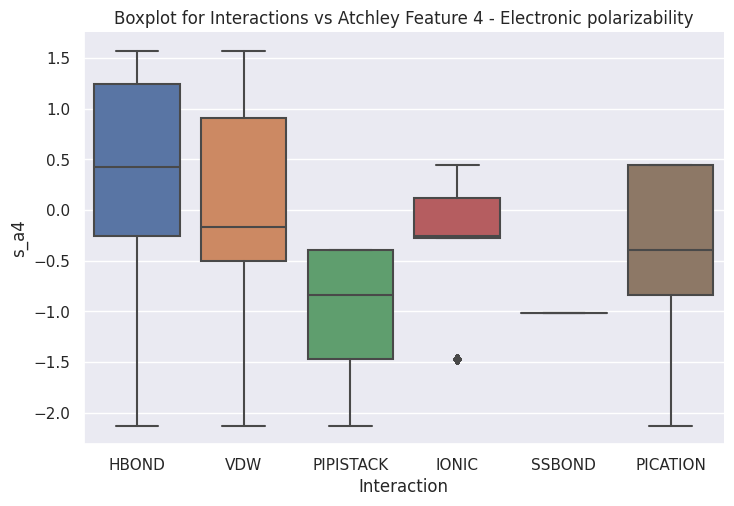

In [ ]:
sns.catplot(x="Interaction", y="s_a4", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Atchley Feature 4 - Electronic polarizability")
plt.show()

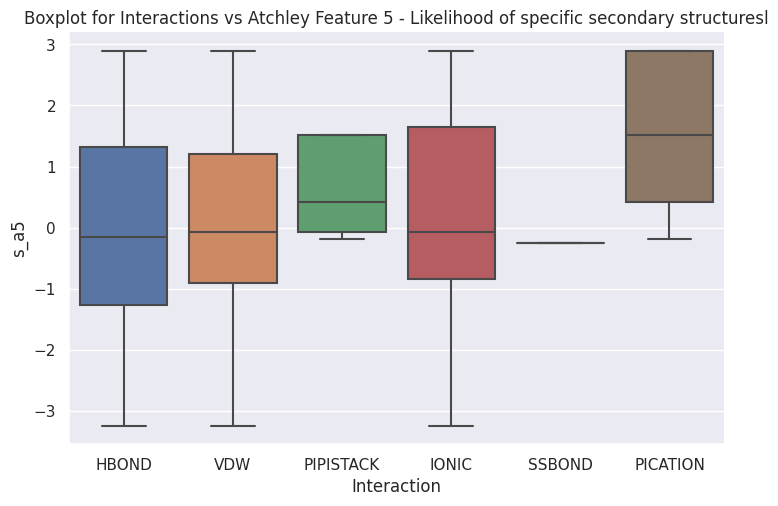

In [ ]:
sns.catplot(x="Interaction", y="s_a5", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Atchley Feature 5 - Likelihood of specific secondary structuresl")
plt.show()

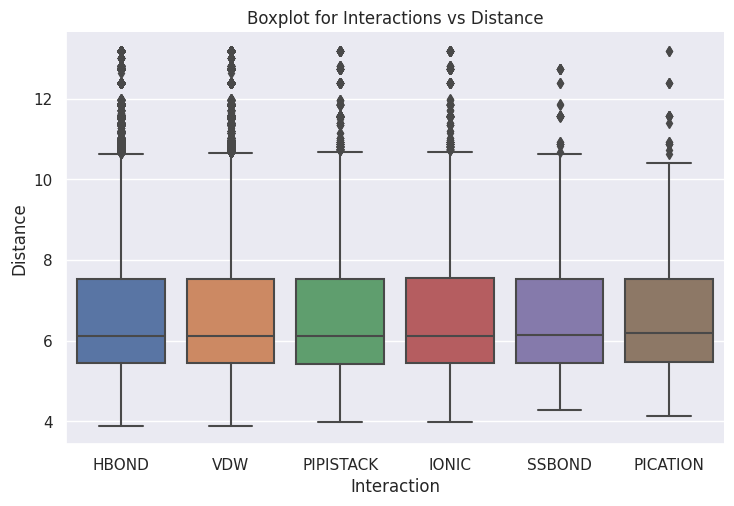

In [ ]:
# for the additional features dataset
sns.catplot(x="Interaction", y="Distance", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Distance")
plt.show()

In [7]:
df.columns

Index(['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 's_ss8', 's_rsa', 's_up',
       's_down', 's_phi', 's_psi', 's_ss3', 's_a1', 's_a2', 's_a3', 's_a4',
       's_a5', 't_ch', 't_resi', 't_ins', 't_resn', 't_ss8', 't_rsa', 't_up',
       't_down', 't_phi', 't_psi', 't_ss3', 't_a1', 't_a2', 't_a3', 't_a4',
       't_a5', 'Distance', 's_residue_hydrophobicity',
       't_residue_hydrophobicity', 's_residue_isoelectric_point',
       't_residue_isoelectric_point', 's_residue_aromatic',
       't_residue_aromatic', 'Interaction'],
      dtype='object')

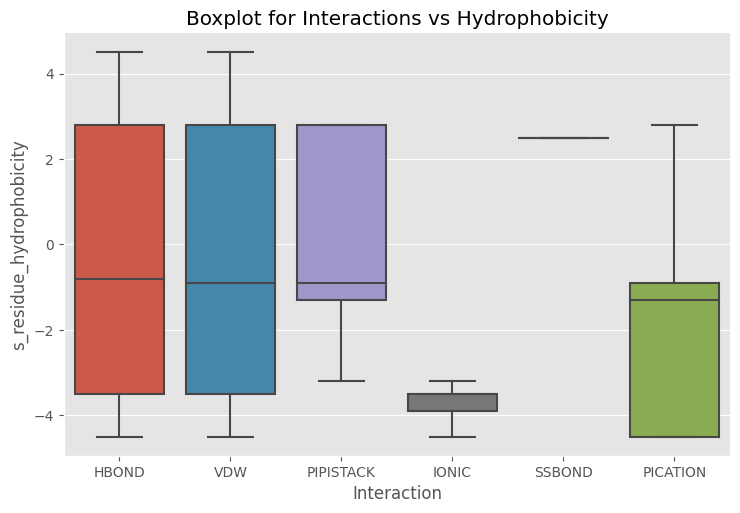

In [9]:
# for the additional features dataset
sns.catplot(x="Interaction", y="s_residue_hydrophobicity", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Hydrophobicity")
plt.show()

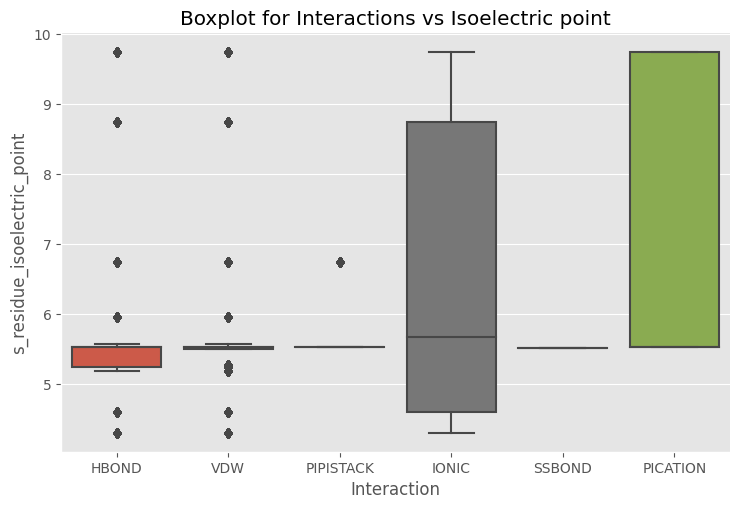

In [10]:
# for the additional features dataset
sns.catplot(x="Interaction", y="s_residue_isoelectric_point", data=df, kind="box", aspect=1.5)
plt.title("Boxplot for Interactions vs Isoelectric point")
plt.show()

In [ ]:
df

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_down,t_phi,t_psi,t_ss3,t_a1,t_a2,t_a3,t_a4,t_a5,Interaction
0,6iyg,A,246,,S,H,0.000,26.0,18.0,-0.994,...,20.0,0.914,0.757,L,1.831,-0.561,0.533,-0.277,1.648,HBOND
2,6iyg,A,136,,W,B,0.013,15.0,22.0,-2.153,...,8.0,-1.199,-0.375,H,1.050,0.302,-3.656,-0.259,-3.242,HBOND
4,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,15.0,-1.381,-0.597,H,0.931,-0.179,-3.005,-0.503,-1.853,HBOND
5,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,15.0,-1.381,-0.597,H,0.931,-0.179,-3.005,-0.503,-1.853,VDW
6,6iyg,A,49,,D,T,0.080,20.0,11.0,-1.293,...,14.0,-2.142,-0.184,H,0.260,0.830,3.097,-0.838,1.512,HBOND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122,6j2m,A,428,,G,H,0.000,20.0,13.0,-1.049,...,13.0,-1.254,-0.594,H,-0.384,1.652,1.330,1.045,2.064,HBOND
123,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,14.0,-2.565,2.755,H,-1.006,-0.590,1.891,-0.397,0.412,HBOND
124,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,14.0,-2.565,2.755,H,-1.006,-0.590,1.891,-0.397,0.412,VDW
129,6j2m,A,427,,K,H,0.644,10.0,17.0,-1.034,...,13.0,-1.839,0.155,H,-0.663,-1.524,2.219,-1.005,1.212,HBOND


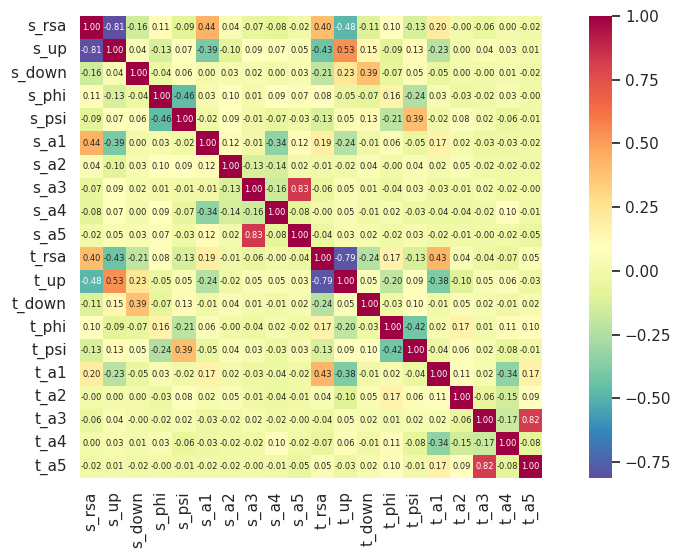

In [ ]:
columns_dropped = ['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 't_ch', 't_resi', 't_ins', 't_resn', 's_ss3', 't_ss3', 's_ss8', 't_ss8', 'Interaction' ]

corrmat = df.drop(columns_dropped, axis=1).corr()
hm = sns.heatmap(corrmat,
                 cbar=True,
                 annot=True,
                 square=True,
                 fmt='.2f',
                  annot_kws={'size': 6},
                 yticklabels= [x for x in list(df.columns)  if x not in columns_dropped],
                 xticklabels=[x for x in list(df.columns)  if x not in columns_dropped],
                 cmap="Spectral_r")
plt.show()

From the correlation matrix between the numerical variables, we may observe high negative correlation between RSA feature with Half sphere exposure up (quantify the surface exposure/accessibility to solvent of a protein residue within its three-dimensional structure feature). The value of the correlation is around -0.80. The conclusion would be residues with greater solvent accessibility are more likely to have less exposure to the upper hemisphere.

Another interesting scenario is the positive correlation of around 0.83 between Atchley features 3 (steric parameters - info about spatial requirements and interactions of atoms or groups within a molecule) and 5 (secondary structure likelihood). The conclusion would be amino acids with larger steric properties tend to have a higher probability of adopting a specific secondary structure.

We have also plotted separate correlation matrix with the additional features dataset. We saw that the hydrophobicity feature we added is highly negatively correlated with the first Atchley factor. Therefore we will exclude this feature in the model training later on.

In [7]:
df.columns

Index(['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 's_ss8', 's_rsa', 's_up',
       's_down', 's_phi', 's_psi', 's_ss3', 's_a1', 's_a2', 's_a3', 's_a4',
       's_a5', 't_ch', 't_resi', 't_ins', 't_resn', 't_ss8', 't_rsa', 't_up',
       't_down', 't_phi', 't_psi', 't_ss3', 't_a1', 't_a2', 't_a3', 't_a4',
       't_a5', 'Distance', 's_residue_hydrophobicity',
       't_residue_hydrophobicity', 's_residue_isoelectric_point',
       't_residue_isoelectric_point', 's_residue_aromatic',
       't_residue_aromatic', 'Interaction'],
      dtype='object')

In [10]:
col_names = ['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 's_ss8', 's_rsa', 's_up',
       's_down', 's_phi', 's_psi', 's_ss3', 's_a1', 's_a2', 's_a3', 's_a4',
       's_a5', 't_ch', 't_resi', 't_ins', 't_resn', 't_ss8', 't_rsa', 't_up',
       't_down', 't_phi', 't_psi', 't_ss3', 't_a1', 't_a2', 't_a3', 't_a4',
       't_a5', 'dist', 's_hyd',
       't_hyd', 's_ip',
       't_ip', 's_ar',
       't_ar', 'Interaction']

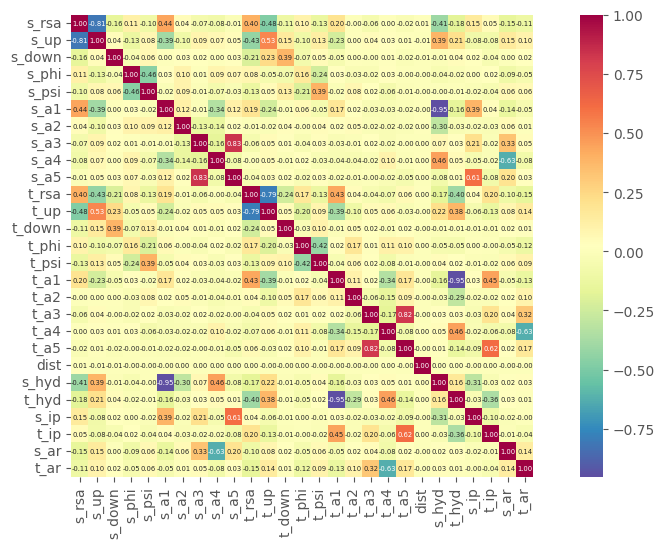

In [15]:
columns_dropped = ['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 't_ch', 't_resi', 't_ins', 't_resn', 's_ss3', 't_ss3', 's_ss8', 't_ss8', 'Interaction' ]

corrmat = df.drop(columns_dropped, axis=1).corr()
hm = sns.heatmap(corrmat,
                 cbar=True,
                 annot=True,
                 square=True,
                 fmt='.2f',
                  annot_kws={'size': 4.9},
                 yticklabels= [x for x in col_names  if x not in columns_dropped],
                 xticklabels=[x for x in col_names  if x not in columns_dropped],
                 cmap="Spectral_r")
plt.show()

# Training models

In [ ]:
df.head()

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_a4,t_a5,Distance,s_residue_hydrophobicity,t_residue_hydrophobicity,s_residue_isoelectric_point,t_residue_isoelectric_point,s_residue_aromatic,t_residue_aromatic,Interaction
0,6iyg,A,246,,S,H,0.000,26.0,18.0,-0.994,...,-0.277,1.648,5.502789,-0.8,-3.9,5.240009,8.750052,False,False,HBOND
1,6iyg,A,136,,W,B,0.013,15.0,22.0,-2.153,...,-0.259,-3.242,6.184382,-0.9,-3.5,5.525000,4.299381,True,False,HBOND
2,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,-0.503,-1.853,10.881779,-3.9,-3.5,8.750052,5.525000,False,False,HBOND
3,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,-0.503,-1.853,8.005460,-3.9,-3.5,8.750052,5.525000,False,False,VDW
4,6iyg,A,49,,D,T,0.080,20.0,11.0,-1.293,...,-0.838,1.512,7.902977,-3.5,-1.3,4.299381,5.524318,False,True,HBOND


In [ ]:
df.columns

Index(['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 's_ss8', 's_rsa', 's_up',
       's_down', 's_phi', 's_psi', 's_ss3', 's_a1', 's_a2', 's_a3', 's_a4',
       's_a5', 't_ch', 't_resi', 't_ins', 't_resn', 't_ss8', 't_rsa', 't_up',
       't_down', 't_phi', 't_psi', 't_ss3', 't_a1', 't_a2', 't_a3', 't_a4',
       't_a5', 'Interaction'],
      dtype='object')

In [ ]:
df.columns

Index(['pdb_id', 's_ch', 's_resi', 's_ins', 's_resn', 's_ss8', 's_rsa', 's_up',
       's_down', 's_phi', 's_psi', 's_ss3', 's_a1', 's_a2', 's_a3', 's_a4',
       's_a5', 't_ch', 't_resi', 't_ins', 't_resn', 't_ss8', 't_rsa', 't_up',
       't_down', 't_phi', 't_psi', 't_ss3', 't_a1', 't_a2', 't_a3', 't_a4',
       't_a5', 'Interaction'],
      dtype='object')

In [8]:
df1 = df.copy()

In [9]:
############# run this ONLY IF working with additional features dataset  #########
df1 = df1.drop(['s_residue_hydrophobicity', 't_residue_hydrophobicity'], axis=1)

In [ ]:
df1['s_ss8'].values

In [10]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

label_encoder = LabelEncoder()

# Fit and transform the categorical column
encoded_values = label_encoder.fit_transform(df1['s_ss8'])

print(encoded_values)

[4 1 4 ... 2 4 4]


In [14]:
df1['s_ss8'].values

array(['H', 'B', 'H', ..., 'E', 'H', 'H'], dtype=object)

In [12]:
label_encoder.classes_

array(['-', 'B', 'E', 'G', 'H', 'I', 'S', 'T'], dtype=object)

In [13]:
mapping = dict(zip(range(len(label_encoder.classes_)), label_encoder.classes_))

# Print the mapping
for label, value in mapping.items():
    print(f"Encoded label: {label}, Original value: {value}")

Encoded label: 0, Original value: -
Encoded label: 1, Original value: B
Encoded label: 2, Original value: E
Encoded label: 3, Original value: G
Encoded label: 4, Original value: H
Encoded label: 5, Original value: I
Encoded label: 6, Original value: S
Encoded label: 7, Original value: T


In [ ]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

label_encoder = LabelEncoder()

# Fit and transform the categorical column
encoded_values = label_encoder.fit_transform(df1['s_ss8'])

print(encoded_values)

[4 1 4 ... 2 4 4]


In [ ]:
df1['s_ss8'] = encoded_values


In [15]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

label_encoder = LabelEncoder()

# Fit and transform the categorical column
encoded_values = label_encoder.fit_transform(df1['s_ss3'])

print(encoded_values)

[0 0 0 ... 0 0 0]


In [16]:
mapping = dict(zip(range(len(label_encoder.classes_)), label_encoder.classes_))

# Print the mapping
for label, value in mapping.items():
    print(f"Encoded label: {label}, Original value: {value}")

Encoded label: 0, Original value: H
Encoded label: 1, Original value: L


In [ ]:
df1['s_ss3'] = encoded_values


In [ ]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

label_encoder = LabelEncoder()

# Fit and transform the categorical column
encoded_values = label_encoder.fit_transform(df1['t_ss3'])

print(encoded_values)
df1['t_ss3'] = encoded_values

label_encoder = LabelEncoder()

# Fit and transform the categorical column
encoded_values = label_encoder.fit_transform(df1['t_ss8'])

print(encoded_values)
df1['t_ss8'] = encoded_values

[1 0 0 ... 0 0 0]
[7 3 4 ... 2 3 3]


In [ ]:
df1.head()

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_a2,t_a3,t_a4,t_a5,Distance,s_residue_isoelectric_point,t_residue_isoelectric_point,s_residue_aromatic,t_residue_aromatic,Interaction
0,6iyg,A,246,,S,4,0.000,26.0,18.0,-0.994,...,-0.561,0.533,-0.277,1.648,5.502789,5.240009,8.750052,False,False,HBOND
1,6iyg,A,136,,W,1,0.013,15.0,22.0,-2.153,...,0.302,-3.656,-0.259,-3.242,6.184382,5.525000,4.299381,True,False,HBOND
2,6iyg,A,259,,K,4,0.000,17.0,23.0,-1.043,...,-0.179,-3.005,-0.503,-1.853,10.881779,8.750052,5.525000,False,False,HBOND
3,6iyg,A,259,,K,4,0.000,17.0,23.0,-1.043,...,-0.179,-3.005,-0.503,-1.853,8.005460,8.750052,5.525000,False,False,VDW
4,6iyg,A,49,,D,7,0.080,20.0,11.0,-1.293,...,0.830,3.097,-0.838,1.512,7.902977,4.299381,5.524318,False,True,HBOND


In [ ]:
grouped_df = df1.drop(["pdb_id"], axis=1).groupby(['s_ch', 's_resi', 's_ins', 's_resn', 't_ch', 't_resi', 't_ins', 't_resn' ])

# List to store the values from all groups
all_group_values = []
X_list = []
y_list = []

label_dict = {"HBOND": 0,
              "IONIC": 1,
              "PICATION": 2,
              "PIPISTACK": 3,
              "SSBOND": 4,
              "VDW": 5 }

# Iterate over the groups and extract values
for group_name, group_df in grouped_df:
    # print(group_name)
    # print(group_df)  # contains all rows which are the same except for the class value
    values_within_group = group_df['Interaction'].tolist()
    row = group_df.iloc[:1,:-1].drop(['s_ch', 's_resi', 's_ins', 's_resn', 't_ch', 't_resi', 't_ins', 't_resn'], axis =1).values

    # print(row[0])
    # print(values_within_group)  # we want this to be our y
    X_list.append(list(row[0]))

    # one-hot encoding
    labels_list = [0,0,0,0,0,0]
    for label in values_within_group:
      labels_list[label_dict[label]]= 1

    # print(labels_list)
    y_list.append(labels_list)
    # print()

    # all_group_values.extend(values_within_group)

# print(all_group_values)

In [39]:
df1.shape

(451872, 39)

In [40]:
np.array(X_list).shape


(326367, 29)

In [41]:
np.array(y_list).shape

(326367, 6)

In [ ]:
y_list

In [ ]:
label_counter_list = []

for label_list in y_list:
  count_ones = label_list.count(1)
  label_counter_list.append(count_ones)


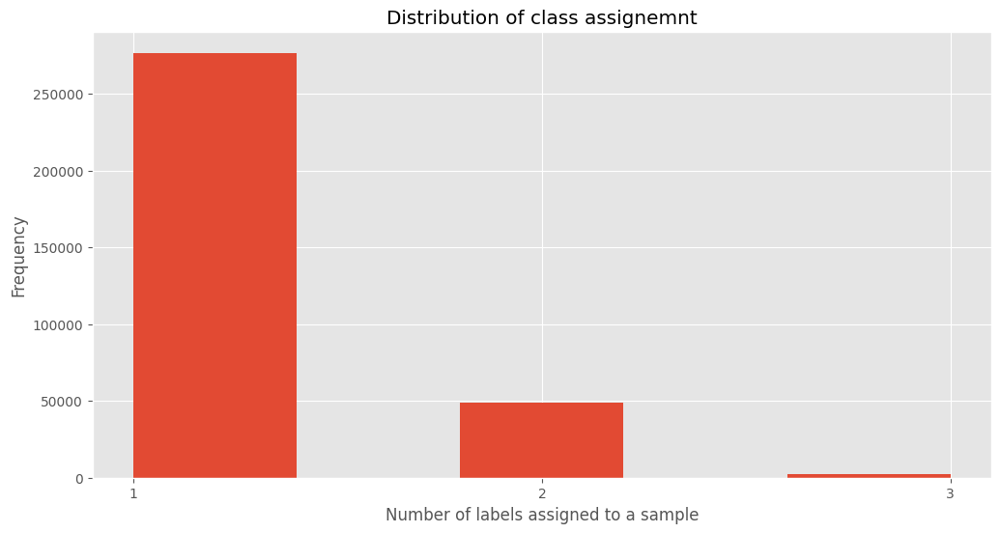

In [ ]:
plt.hist(label_counter_list, bins=5)  # Adjust the number of bins as desired
plt.xlabel('Number of labels assigned to a sample')
plt.ylabel('Frequency')
plt.title('Distribution of class assignemnt')

plt.xticks(range(min(label_counter_list), max(label_counter_list)+1))
plt.show()

And for the features dataset:

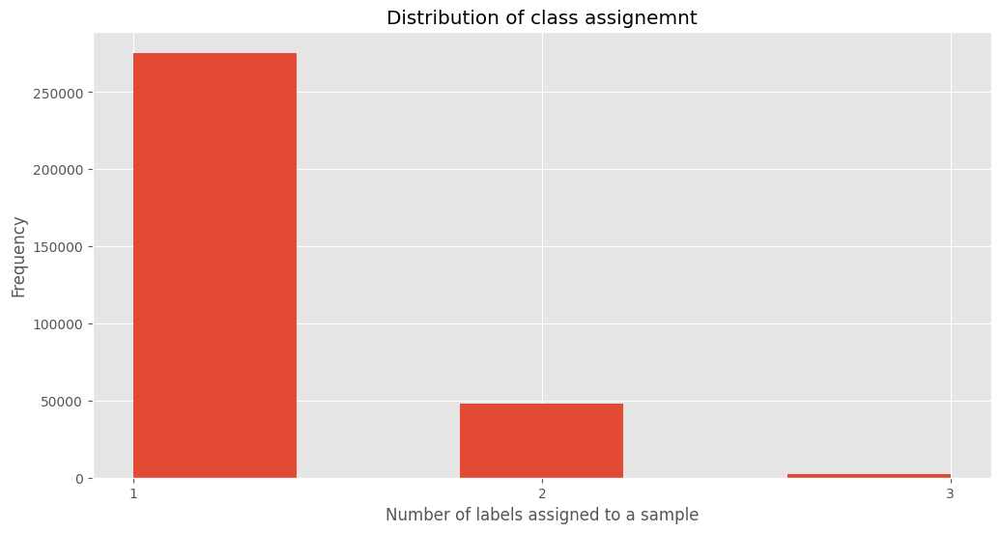

In [ ]:
plt.hist(label_counter_list, bins=5)  # Adjust the number of bins as desired
plt.xlabel('Number of labels assigned to a sample')
plt.ylabel('Frequency')
plt.title('Distribution of class assignemnt')

plt.xticks(range(min(label_counter_list), max(label_counter_list)+1))
plt.show()

From the given histogram we may conclude that most of our data samples are assigned one label only, around 50K have 2 labels and significantly fewer around 2.5K have 3 labels assigned.

In [ ]:
from collections import Counter


frequency_count = Counter(label_counter_list)
print(frequency_count)

Counter({1: 276631, 2: 48554, 3: 2551})


And for the additional features dataset:

In [ ]:
from collections import Counter


frequency_count = Counter(label_counter_list)
print(frequency_count)

Counter({1: 275530, 2: 48303, 3: 2534})


Binary cross-entropy loss is typically used with the sigmoid activation function, which allows for independent and non-exclusive prediction of each class.

The sigmoid activation function produces outputs in the range of [0, 1] for each class, representing the probability of that class being present. The binary cross-entropy loss compares these probabilities with the true labels for each class independently.

Sigmoid activation can be used when each class is considered as an independent binary classification problem.
The output layer will have one neuron per class, and each neuron will have a sigmoid activation function.
Each neuron will produce a probability value between 0 and 1, indicating the likelihood of the input belonging to that class.
This allows for independent predictions for each class, allowing a sample to be assigned multiple labels simultaneously.
Sigmoid activation can be suitable when instances can belong to multiple classes without exclusivity.

In [42]:
# mlp for multi-label classification
from numpy import mean
from numpy import std
from sklearn.datasets import make_multilabel_classification
from sklearn.model_selection import RepeatedKFold
from keras.models import Sequential
from keras.layers import Dense
from sklearn.metrics import accuracy_score
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import multilabel_confusion_matrix
import keras


def NN_model(n_inputs, n_outputs):
	model = Sequential()
	model.add(Dense(20, input_dim=n_inputs, kernel_initializer='he_uniform', activation='relu'))
	model.add(Dense(n_outputs, activation='sigmoid'))
	model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy', keras.metrics.Precision(), keras.metrics.Recall()])
	return model

In [ ]:
# evaluate a model using repeated k-fold cross-validation
def train_and_evaluate_NN_model(X, y):
	results = list()
	results_precision = list()
	results_recall = list()
	results_f1 = list()
	n_inputs, n_outputs = X.shape[1], y.shape[1]
	# define evaluation procedure
	cv = RepeatedKFold(n_splits=10, n_repeats=1, random_state=1)
	# enumerate folds
	i = 0
	for train_ix, test_ix in cv.split(X):
		i += 1
		print("=============================== ITERATION ", str(i), " ======================================")
		# prepare data
		X_train, X_test = X[train_ix], X[test_ix]
		y_train, y_test = y[train_ix], y[test_ix]
		# define model
		model = NN_model(n_inputs, n_outputs)
		# fit model
		early_stopping = EarlyStopping(monitor='loss', patience=3, restore_best_weights=True)
		model.fit(X_train, y_train, verbose=1, epochs=30, callbacks=[early_stopping], validation_split=0.2)
		# make a prediction on the test set
		yhat = model.predict(X_test)
		# round probabilities to class labels
		yhat = yhat.round()
		# calculate accuracy
		acc = accuracy_score(y_test, yhat)

		testy = y_test
		yhat_classes = yhat

		# precision tp / (tp + fp)
		precision = precision_score(testy, yhat_classes, average='micro')
		print('Precision: %f' % precision)
		# recall: tp / (tp + fn)
		recall = recall_score(testy, yhat_classes, average='micro')
		print('Recall: %f' % recall)
		# f1: 2 tp / (2 tp + fp + fn)
		f1 = f1_score(testy, yhat_classes, average='micro')
		print('F1 score: %f' % f1)
		# confusion matrix
		print("Confusion matrix: ")
		matrix = multilabel_confusion_matrix(testy, yhat_classes)
		print(matrix)

		# store result
		print('>%.3f' % acc)
		results.append(acc)
		results_precision.append(precision)
		results_recall.append(recall)
		results_f1.append(f1)
		print()
	return results, results_precision, results_recall, results_f1

# load dataset
X, y = np.array(X_list), np.array(y_list)
# evaluate model
results, results_precision, results_recall, results_f1 = train_and_evaluate_NN_model(X, y)

print('Accuracy: %.3f (%.3f)' % (mean(results), std(results)))
print('Precision: %.3f (%.3f)' % (mean(results_precision), std(results_precision)))
print('Recall: %.3f (%.3f)' % (mean(results_recall), std(results_recall)))
print('F1: %.3f (%.3f)' % (mean(results_f1), std(results_f1)))

=============================== ITERATION  1  ======================================
Epoch 1/30
7375/7375 [==============================] - 18s 2ms/step - loss: 0.2456 - accuracy: 0.6684 - precision_25: 0.6796 - recall_25: 0.7009 - val_loss: 0.1966 - val_accuracy: 0.7409 - val_precision_25: 0.7305 - val_recall_25: 0.7898
Epoch 2/30
7375/7375 [==============================] - 17s 2ms/step - loss: 0.2183 - accuracy: 0.6854 - precision_25: 0.7039 - recall_25: 0.7193 - val_loss: 0.1951 - val_accuracy: 0.7367 - val_precision_25: 0.7567 - val_recall_25: 0.7408
Epoch 3/30
7375/7375 [==============================] - 17s 2ms/step - loss: 0.2150 - accuracy: 0.6902 - precision_25: 0.7100 - recall_25: 0.7243 - val_loss: 0.1946 - val_accuracy: 0.7382 - val_precision_25: 0.7307 - val_recall_25: 0.7985
Epoch 4/30
7375/7375 [==============================] - 18s 2ms/step - loss: 0.2136 - accuracy: 0.6925 - precision_25: 0.7115 - recall_25: 0.7255 - val_loss: 0.1957 - val_accuracy: 0.7178 - val_prec

With the additional features dataset:

In [43]:
# evaluate a model using repeated k-fold cross-validation
def train_and_evaluate_NN_model(X, y):
	results = list()
	results_precision = list()
	results_recall = list()
	results_f1 = list()
	n_inputs, n_outputs = X.shape[1], y.shape[1]
	# define evaluation procedure
	cv = RepeatedKFold(n_splits=2, n_repeats=1, random_state=1)
	# enumerate folds
	i = 0
	for train_ix, test_ix in cv.split(X):
		i += 1
		print("=============================== ITERATION ", str(i), " ======================================")
		# prepare data
		X_train, X_test = X[train_ix], X[test_ix]
		y_train, y_test = y[train_ix], y[test_ix]
		# define model
		model = NN_model(n_inputs, n_outputs)
		# fit model
		early_stopping = EarlyStopping(monitor='loss', patience=3, restore_best_weights=True)
		model.fit(X_train, y_train, verbose=1, epochs=30, callbacks=[early_stopping], validation_split=0.2)
		# make a prediction on the test set
		yhat = model.predict(X_test)
		# round probabilities to class labels
		yhat = yhat.round()
		# calculate accuracy
		acc = accuracy_score(y_test, yhat)

		testy = y_test
		yhat_classes = yhat

		# precision tp / (tp + fp)
		precision = precision_score(testy, yhat_classes, average='micro')
		print('Precision: %f' % precision)
		# recall: tp / (tp + fn)
		recall = recall_score(testy, yhat_classes, average='micro')
		print('Recall: %f' % recall)
		# f1: 2 tp / (2 tp + fp + fn)
		f1 = f1_score(testy, yhat_classes, average='micro')
		print('F1 score: %f' % f1)
		# confusion matrix
		print("Confusion matrix: ")
		matrix = multilabel_confusion_matrix(testy, yhat_classes)
		print(matrix)

		# store result
		print('>%.3f' % acc)
		results.append(acc)
		results_precision.append(precision)
		results_recall.append(recall)
		results_f1.append(f1)
		print()
	return results, results_precision, results_recall, results_f1

# load dataset
X, y = np.array(X_list), np.array(y_list)
# evaluate model
results, results_precision, results_recall, results_f1 = train_and_evaluate_NN_model(X, y)

print('Accuracy: %.3f (%.3f)' % (mean(results), std(results)))
print('Precision: %.3f (%.3f)' % (mean(results_precision), std(results_precision)))
print('Recall: %.3f (%.3f)' % (mean(results_recall), std(results_recall)))
print('F1: %.3f (%.3f)' % (mean(results_f1), std(results_f1)))

=============================== ITERATION  1  ======================================
Epoch 1/30
4080/4080 [==============================] - 14s 3ms/step - loss: 0.2537 - accuracy: 0.6677 - precision_2: 0.6815 - recall_2: 0.6942 - val_loss: 0.1988 - val_accuracy: 0.7399 - val_precision_2: 0.7376 - val_recall_2: 0.7703
Epoch 2/30
4080/4080 [==============================] - 10s 2ms/step - loss: 0.2177 - accuracy: 0.6835 - precision_2: 0.7037 - recall_2: 0.7183 - val_loss: 0.1946 - val_accuracy: 0.7321 - val_precision_2: 0.7398 - val_recall_2: 0.7652
Epoch 3/30
4080/4080 [==============================] - 9s 2ms/step - loss: 0.2115 - accuracy: 0.6915 - precision_2: 0.7106 - recall_2: 0.7290 - val_loss: 0.1884 - val_accuracy: 0.7479 - val_precision_2: 0.7622 - val_recall_2: 0.7517
Epoch 4/30
4080/4080 [==============================] - 10s 2ms/step - loss: 0.2077 - accuracy: 0.6974 - precision_2: 0.7153 - recall_2: 0.7374 - val_loss: 0.1872 - val_accuracy: 0.7399 - val_precision_2: 0.7553

Having a higher precision and recall compared to accuracy in a multi-label problem suggests that the model is better at identifying the relevant labels but may struggle with predicting the absence of irrelevant labels. Further analysis and fine-tuning of the model may be required to improve its performance in correctly predicting negative labels.

Next we will run a hyper-parameter tuning on several parameters of the neural network model, that is number of layers, number of layer units, amount of dropout after each layer and the learning rate. The output of the following code should give the results for the best hyperparameters from the given grid.

Binary cross-entropy loss is typically used with the sigmoid activation function, which allows for independent and non-exclusive prediction of each class.

The sigmoid activation function produces outputs in the range of [0, 1] for each class, representing the probability of that class being present. The binary cross-entropy loss compares these probabilities with the true labels for each class independently.

In [ ]:
# mlp for multi-label classification
from numpy import mean
from numpy import std
from sklearn.datasets import make_multilabel_classification
from sklearn.model_selection import RepeatedKFold
from keras.models import Sequential
from keras.layers import Dense
from sklearn.metrics import accuracy_score
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import multilabel_confusion_matrix
import keras


def NN_model(n_inputs, n_outputs):
	model = Sequential()
	model.add(Dense(20, input_dim=n_inputs, kernel_initializer='he_uniform', activation='relu'))
	model.add(Dense(n_outputs, activation='sigmoid'))
	model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy', keras.metrics.Precision(), keras.metrics.Recall()])
	return model

In [ ]:
# evaluate a model using repeated k-fold cross-validation
def train_and_evaluate_NN_model(X, y):
	results = list()
	results_precision = list()
	results_recall = list()
	results_f1 = list()
	n_inputs, n_outputs = X.shape[1], y.shape[1]
	# define evaluation procedure
	cv = RepeatedKFold(n_splits=10, n_repeats=1, random_state=1)
	# enumerate folds
	i = 0
	for train_ix, test_ix in cv.split(X):
		i += 1
		print("=============================== ITERATION ", str(i), " ======================================")
		# prepare data
		X_train, X_test = X[train_ix], X[test_ix]
		y_train, y_test = y[train_ix], y[test_ix]
		# define model
		model = NN_model(n_inputs, n_outputs)
		# fit model
		early_stopping = EarlyStopping(monitor='loss', patience=3, restore_best_weights=True)
		model.fit(X_train, y_train, verbose=1, epochs=30, callbacks=[early_stopping], validation_split=0.2)
		# make a prediction on the test set
		yhat = model.predict(X_test)
		# round probabilities to class labels
		yhat = yhat.round()
		# calculate accuracy
		acc = accuracy_score(y_test, yhat)

		testy = y_test
		yhat_classes = yhat

		# precision tp / (tp + fp)
		precision = precision_score(testy, yhat_classes, average='micro')
		print('Precision: %f' % precision)
		# recall: tp / (tp + fn)
		recall = recall_score(testy, yhat_classes, average='micro')
		print('Recall: %f' % recall)
		# f1: 2 tp / (2 tp + fp + fn)
		f1 = f1_score(testy, yhat_classes, average='micro')
		print('F1 score: %f' % f1)
		# confusion matrix
		print("Confusion matrix: ")
		matrix = multilabel_confusion_matrix(testy, yhat_classes)
		print(matrix)

		# store result
		print('>%.3f' % acc)
		results.append(acc)
		results_precision.append(precision)
		results_recall.append(recall)
		results_f1.append(f1)
		print()
	return results, results_precision, results_recall, results_f1

# load dataset
X, y = np.array(X_list), np.array(y_list)
# evaluate model
results, results_precision, results_recall, results_f1 = train_and_evaluate_NN_model(X, y)

print('Accuracy: %.3f (%.3f)' % (mean(results), std(results)))
print('Precision: %.3f (%.3f)' % (mean(results_precision), std(results_precision)))
print('Recall: %.3f (%.3f)' % (mean(results_recall), std(results_recall)))
print('F1: %.3f (%.3f)' % (mean(results_f1), std(results_f1)))

=============================== ITERATION  1  ======================================
Epoch 1/30
7375/7375 [==============================] - 18s 2ms/step - loss: 0.2456 - accuracy: 0.6684 - precision_25: 0.6796 - recall_25: 0.7009 - val_loss: 0.1966 - val_accuracy: 0.7409 - val_precision_25: 0.7305 - val_recall_25: 0.7898
Epoch 2/30
7375/7375 [==============================] - 17s 2ms/step - loss: 0.2183 - accuracy: 0.6854 - precision_25: 0.7039 - recall_25: 0.7193 - val_loss: 0.1951 - val_accuracy: 0.7367 - val_precision_25: 0.7567 - val_recall_25: 0.7408
Epoch 3/30
7375/7375 [==============================] - 17s 2ms/step - loss: 0.2150 - accuracy: 0.6902 - precision_25: 0.7100 - recall_25: 0.7243 - val_loss: 0.1946 - val_accuracy: 0.7382 - val_precision_25: 0.7307 - val_recall_25: 0.7985
Epoch 4/30
7375/7375 [==============================] - 18s 2ms/step - loss: 0.2136 - accuracy: 0.6925 - precision_25: 0.7115 - recall_25: 0.7255 - val_loss: 0.1957 - val_accuracy: 0.7178 - val_prec

Having a higher precision and recall compared to accuracy in a multi-label problem suggests that the model is better at identifying the relevant labels but may struggle with predicting the absence of irrelevant labels. Further analysis and fine-tuning of the model may be required to improve its performance in correctly predicting negative labels.

Next we will run a hyper-parameter tuning on several parameters of the neural network model, that is number of layers, number of layer units, amount of dropout after each layer and the learning rate. The output of the following code should give the results for the best hyperparameters from the given grid.

In [ ]:
import numpy as np
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import accuracy_score
from sklearn.utils import class_weight
from tensorflow.keras.optimizers import Adam
# from scikeras.wrappers import KerasClassifier

# num_samples = 1000
# num_features = 24
# num_classes = 6

num_features, num_classes = np.array(X_list).shape[1], np.array(y_list).shape[1]


X_train, X_test, y_train, y_test = train_test_split(np.array(X_list), np.array(y_list), test_size=0.2, random_state=42)
# Compute class weights
# sample_weights = class_weight.compute_sample_weight(class_weight='balanced', y=y_train)
# print(sample_weights.shape)
# print(sample_weights)



# Define the model
def create_model(num_layers=1, hidden_units=64, dropout_rate=0.2, learning_rate=0.001):
    model = Sequential()
    model.add(Dense(hidden_units, activation='relu', kernel_initializer='he_uniform', input_dim=num_features))

    for _ in range(num_layers - 1):
        model.add(Dense(hidden_units, activation='relu'))
        model.add(keras.layers.Dropout(dropout_rate))

    model.add(Dense(num_classes, activation='sigmoid'))
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy', keras.metrics.Precision(), keras.metrics.Recall()])
    return model

# Define the hyperparameters to search
param_grid = {
    'num_layers': [1, 2, 3],
    'hidden_units': [32, 64, 128],
    'dropout_rate': [0.2, 0.4, 0.6],
    'learning_rate': [0.001, 0.01, 0.1]
}

# Create the model
model_1 = keras.wrappers.scikit_learn.KerasClassifier(build_fn=create_model, epochs=10, batch_size=32)

# model_1 = KerasClassifier(model=create_model, epochs=10, batch_size=32)

# Perform grid search with cross-validation
grid_search = GridSearchCV(estimator=model_1, param_grid=param_grid, cv=3)
grid_result = grid_search.fit(X_train, y_train) # sample_weight=sample_weights)

# Print the best parameters and best score
print("Best Parameters: ", grid_result.best_params_)
print("Best Score: ", grid_result.best_score_)

# Evaluate the model with best parameters on the test set
best_model = grid_result.best_estimator_
y_pred = best_model.predict(X_test)
y_pred = y_pred.round()
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)


Epoch 1/10


<ipython-input-61-4d2afa34c3fb>:49: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model_1 = keras.wrappers.scikit_learn.KerasClassifier(build_fn=create_model, epochs=10, batch_size=32)


5463/5463 [==============================] - 14s 2ms/step - loss: 0.2349 - accuracy: 0.6876 - precision_243: 0.6972 - recall_243: 0.7088
Epoch 2/10
5463/5463 [==============================] - 11s 2ms/step - loss: 0.2115 - accuracy: 0.7009 - precision_243: 0.7178 - recall_243: 0.7262
Epoch 3/10
5463/5463 [==============================] - 21s 4ms/step - loss: 0.2058 - accuracy: 0.7046 - precision_243: 0.7238 - recall_243: 0.7331
Epoch 4/10
5463/5463 [==============================] - 12s 2ms/step - loss: 0.2019 - accuracy: 0.7091 - precision_243: 0.7277 - recall_243: 0.7424
Epoch 5/10
5463/5463 [==============================] - 17s 3ms/step - loss: 0.1984 - accuracy: 0.7130 - precision_243: 0.7316 - recall_243: 0.7504
Epoch 6/10
5463/5463 [==============================] - 12s 2ms/step - loss: 0.1961 - accuracy: 0.7157 - precision_243: 0.7337 - recall_243: 0.7554
Epoch 7/10
5463/5463 [==============================] - 12s 2ms/step - loss: 0.1947 - accuracy: 0.7189 - precision_243: 0.7

By adding so called 'sample_weights' to model for class imbalance awareness of, it does not help much in spite of model performance. It is even worse than before, so we decided that it may be better to try techniques of over or downsampling of the dataset.

## Oversampling / undersampling

For oversampling of multi-label dataset we use ao called MLSMOTE algorithm (https://github.com/niteshsukhwani/MLSMOTE) for synthetic oversampling of instances belonging tu multiple classes. In simple words, this algorithm calculates so called tail-labels, that are the labels such that imbalance ratio per label is greater than the mean imbalance ratio: IRPL(l) > MIR. The set of all the instances of the data which contain that label is considered as minority instance data. In our case it contains 6 tail-labels and 1293 samples in the minority instance.

In [44]:
# -*- coding: utf-8 -*-
# Importing required Library
import numpy as np
import pandas as pd
import random
from sklearn.datasets import make_classification
from sklearn.neighbors import NearestNeighbors


def get_tail_label(df):
    """
    Give tail label colums of the given target dataframe

    args
    df: pandas.DataFrame, target label df whose tail label has to identified

    return
    tail_label: list, a list containing column name of all the tail label
    """
    columns = df.columns
    n = len(columns)
    irpl = np.zeros(n)
    for column in range(n):
        irpl[column] = df[columns[column]].value_counts()[1]
    irpl = max(irpl)/irpl
    mir = np.average(irpl)
    tail_label = []
    for i in range(n):
        if irpl[i] > mir:
            tail_label.append(columns[i])
    return tail_label

def get_index(df):
  """
  give the index of all tail_label rows
  args
  df: pandas.DataFrame, target label df from which index for tail label has to identified

  return
  index: list, a list containing index number of all the tail label
  """
  tail_labels = get_tail_label(df)
  index = set()
  for tail_label in tail_labels:
    sub_index = set(df[df[tail_label]==1].index)
    index = index.union(sub_index)
  return list(index)

def get_minority_instace(X, y):
    """
    Give minority dataframe containing all the tail labels

    args
    X: pandas.DataFrame, the feature vector dataframe
    y: pandas.DataFrame, the target vector dataframe

    return
    X_sub: pandas.DataFrame, the feature vector minority dataframe
    y_sub: pandas.DataFrame, the target vector minority dataframe
    """
    index = get_index(y)
    X_sub = X[X.index.isin(index)].reset_index(drop = True)
    y_sub = y[y.index.isin(index)].reset_index(drop = True)
    return X_sub, y_sub

def nearest_neighbour(X):
    """
    Give index of 5 nearest neighbor of all the instance

    args
    X: np.array, array whose nearest neighbor has to find

    return
    indices: list of list, index of 5 NN of each element in X
    """
    nbs=NearestNeighbors(n_neighbors=5,metric='euclidean',algorithm='kd_tree').fit(X)
    euclidean,indices= nbs.kneighbors(X)
    return indices

def MLSMOTE(X,y, n_sample):
    """
    Give the augmented data using MLSMOTE algorithm

    args
    X: pandas.DataFrame, input vector DataFrame
    y: pandas.DataFrame, feature vector dataframe
    n_sample: int, number of newly generated sample

    return
    new_X: pandas.DataFrame, augmented feature vector data
    target: pandas.DataFrame, augmented target vector data
    """
    indices2 = nearest_neighbour(X)
    n = len(indices2)
    new_X = np.zeros((n_sample, X.shape[1]))
    target = np.zeros((n_sample, y.shape[1]))
    for i in range(n_sample):
        reference = random.randint(0,n-1)
        neighbour = random.choice(indices2[reference,1:])
        all_point = indices2[reference]
        nn_df = y[y.index.isin(all_point)]
        ser = nn_df.sum(axis = 0, skipna = True)
        target[i] = np.array([1 if val>2 else 0 for val in ser])
        ratio = random.random()
        gap = X.loc[reference,:] - X.loc[neighbour,:]
        new_X[i] = np.array(X.loc[reference,:] + ratio * gap)
    new_X = pd.DataFrame(new_X, columns=X.columns)
    target = pd.DataFrame(target, columns=y.columns)
    new_X = pd.concat([X, new_X], axis=0)
    target = pd.concat([y, target], axis=0)
    return new_X, target


Example of the use of the oversampler over the whole dataset:

In [ ]:
if __name__=='__main__':
    """
    main function to use the MLSMOTE
    """
    X_sub, y_sub = get_minority_instace(pd.DataFrame(X_list), pd.DataFrame(y_list, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']))   #Getting minority instance of that datframe
    X_res,y_res =MLSMOTE(X_sub, y_sub, 30000)     #Applying MLSMOTE to augment the dataframe

    X_res[1293:].to_csv(path + "/X_minority_oversampled.csv")
    y_res[1293:].to_csv(path + "/y_minority_oversampled.csv")

In [ ]:
X_list_oversampled =  [list(x) for x in X_res[1293:].values]
y_list_oversampled =  [list(y) for y in y_res[1293:].values]

In [ ]:
type(X_res[1293:].values)

numpy.ndarray

In [ ]:
print(pd.DataFrame(y_list, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']))

        HBOND  IONIC  PICATION  PIPISTACK  SSBOND  VDW
0           1      0         0          0       0    0
1           0      0         0          0       0    1
2           0      0         0          0       0    1
3           1      0         0          0       0    0
4           0      0         0          0       0    1
...       ...    ...       ...        ...     ...  ...
327731      1      0         0          0       0    0
327732      0      0         0          0       0    1
327733      0      0         0          0       0    1
327734      0      0         0          0       0    1
327735      1      0         0          0       0    1

[327736 rows x 6 columns]


In [ ]:
len(X_list_oversampled)

357736

Below we may observe the labelings distribution in the minority sample and the associated augmented sample of it. We may conclude that MLSMOTE algorithm preserves the proportion of labelings even during the augmentation.

In [ ]:
unique_values, counts = np.unique(y_sub.values, axis=0, return_counts=True)

for value, count in zip(unique_values, counts):
    print(value, count)

[0 0 0 0 1 1] 726
[0 0 1 0 0 0] 79
[0 0 1 0 0 1] 376
[1 0 0 0 1 1] 25
[1 0 1 0 0 0] 18
[1 0 1 0 0 1] 69


In [ ]:
unique_values, counts = np.unique(y_res.values, axis=0, return_counts=True)

for value, count in zip(unique_values, counts):
    print(value, count)

[0. 0. 0. 0. 1. 1.] 18572
[0. 0. 1. 0. 0. 0.] 645
[0. 0. 1. 0. 0. 1.] 10845
[1. 0. 0. 0. 1. 1.] 225
[1. 0. 1. 0. 0. 0.] 226
[1. 0. 1. 0. 0. 1.] 780


In [ ]:
unique_values, counts = np.unique(np.array(y_list), axis=0, return_counts=True)

for value, count in zip(unique_values, counts):
    print(value, count)

[0 0 0 0 0 1] 85549
[0 0 0 0 1 1] 726
[0 0 0 1 0 0] 1220
[0 0 0 1 0 1] 5585
[0 0 1 0 0 0] 79
[0 0 1 0 0 1] 376
[0 1 0 0 0 0] 4022
[0 1 0 0 0 1] 1166
[1 0 0 0 0 0] 185761
[1 0 0 0 0 1] 38460
[1 0 0 0 1 1] 25
[1 0 0 1 0 0] 505
[1 0 0 1 0 1] 1665
[1 0 1 0 0 0] 18
[1 0 1 0 0 1] 69
[1 1 0 0 0 0] 1718
[1 1 0 0 0 1] 792


Since out of ~300K instances, around 1300 belong to the minority sample according to MLSMOTE, we have decided to oversample ~300K instances of the minority ones and add it to our dataset and try to train our NN model again on this oversampled data.

In [ ]:
X_res[1293:]

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,7.921263,0.089023,15.307088,17.000000,-0.873622,-0.780709,0.0,0.260000,0.830000,3.097000,...,20.228350,13.921263,-1.564346,-0.529782,0.00000,1.448023,0.100386,1.799568,0.660182,3.280552
1,7.431694,0.018475,5.431694,13.431694,-3.947803,4.954306,0.0,-1.878454,0.791426,-1.960109,...,5.284153,1.420765,-1.263694,2.329148,0.00000,-3.405355,0.837240,-2.554262,-2.065137,-2.511350
2,2.000000,0.025732,16.830381,26.339238,-1.827043,2.569992,0.0,-1.343000,0.465000,-0.862000,...,16.678476,13.830381,-1.368747,2.205129,0.00000,-1.343000,0.465000,-0.862000,-1.020000,-0.255000
3,1.346180,0.074532,9.000000,12.346180,-1.483621,2.568352,0.0,-1.333402,0.031156,0.384671,...,12.000000,12.653820,-0.971682,3.133041,0.00000,1.980418,-0.361369,0.949843,0.882418,3.376459
4,4.000000,0.305632,12.569874,-0.287657,-1.826588,0.065908,0.0,0.260000,0.830000,3.097000,...,13.142469,12.284937,-1.334063,-0.478806,0.00000,1.286743,0.378911,2.332948,1.054850,3.968057
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,7.000000,0.414842,5.193468,27.883919,1.856142,-1.017998,1.0,-1.343000,0.465000,-0.862000,...,9.154774,11.000000,-0.931262,-0.451161,0.00000,-1.343000,0.465000,-0.862000,-1.020000,-0.255000
29996,4.000000,0.119300,13.808318,12.095841,-1.003537,-0.853725,0.0,-1.045391,-0.647409,2.007830,...,6.712478,9.095841,-1.506203,-0.610206,0.00000,1.538000,-0.055000,1.502000,0.440000,2.897000
29997,2.890170,0.229601,13.000000,19.219660,-1.168283,-0.463190,0.0,1.863180,-0.616574,0.426575,...,12.780340,11.780340,-2.609837,2.851377,-0.10983,0.260000,0.830000,3.097000,-0.838000,1.512000
29998,2.819597,0.196376,13.180403,11.458790,-1.200885,-0.175500,0.0,-1.080146,-0.698062,2.110912,...,23.180403,13.819597,-1.982200,0.338775,0.00000,1.538000,-0.055000,1.502000,0.440000,2.897000


In [ ]:
X_res[1293:].values()

In [ ]:
pd.DataFrame(y_list, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW'])

,HBOND,IONIC,PICATION,PIPISTACK,SSBOND,VDW
0,1,0,0,0,0,0
1,0,0,0,0,0,1
2,0,0,0,0,0,1
3,1,0,0,0,0,0
4,0,0,0,0,0,1
...,...,...,...,...,...,...
327731,1,0,0,0,0,0
327732,0,0,0,0,0,1
327733,0,0,0,0,0,1
327734,0,0,0,0,0,1


In [ ]:
np.unique(df1.Interaction.values)

array(['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW'],
      dtype=object)

## Training deeper NN model with oversamploing

In [45]:
# mlp for multi-label classification
from numpy import mean
from numpy import std
from sklearn.datasets import make_multilabel_classification
from sklearn.model_selection import RepeatedKFold
from keras.models import Sequential
from keras.layers import Dense, Dropout
from sklearn.metrics import accuracy_score
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import(
    classification_report,
    matthews_corrcoef,
    balanced_accuracy_score,
    average_precision_score,
    roc_auc_score,
)
from sklearn.metrics import multilabel_confusion_matrix
import keras


def NN_model(n_inputs, n_outputs):
	model = Sequential()
	model.add(Dense(64, input_dim=n_inputs, kernel_initializer='he_uniform', activation='relu'))
	model.add(Dense(32, activation='relu'))
	model.add(Dense(20,  activation='relu'))
	model.add(Dropout(0.1))
	model.add(Dense(n_outputs, activation='sigmoid'))
	model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy', keras.metrics.Precision(), keras.metrics.Recall()])
	return model

In [ ]:
!pip install torchmetrics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 10.7 MB/s eta 0:00:00


In [ ]:
# evaluate a model using repeated k-fold cross-validation
import torch
from torchmetrics.functional.classification import multilabel_matthews_corrcoef

def train_and_evaluate_NN_model(X, y):
	results = list()
	results_precision = list()
	results_recall = list()
	results_f1 = list()
	results_mcc = []
	results_balanced_acc = []
	results_apc = []
	results_auc = []
	n_inputs, n_outputs = X.shape[1], y.shape[1]
	# define evaluation procedure
	cv = RepeatedKFold(n_splits=2, n_repeats=1, random_state=1)
	# enumerate folds
	i = 0
	for train_ix, test_ix in cv.split(X):
		i += 1
		print("=============================== ITERATION ", str(i), " ======================================")
		# prepare data
		X_train, X_test = X[train_ix], X[test_ix]
		y_train, y_test = y[train_ix], y[test_ix]
		# print(pd.DataFrame(y_train, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']).astype(int))


		X_sub, y_sub = get_minority_instace(pd.DataFrame(X_train), pd.DataFrame(y_train, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']).astype(int))   #Getting minority instance of that datframe
		X_res,y_res =MLSMOTE(X_sub, y_sub, int(0.1*len(X_train)))



		X_train = np.concatenate((X_train, X_res[len(X_sub):].values))
		y_train = np.concatenate((y_train, y_res[len(y_sub):].values))

		# define model
		model = NN_model(n_inputs, n_outputs)
		# fit model
		early_stopping = EarlyStopping(monitor='loss', patience=3, restore_best_weights=True)
		history = model.fit(X_train, y_train, verbose=1, epochs=50, callbacks=[early_stopping])

		np.save(path + '/NN_model_history/NN_MLSMOTE_history_' + str(i) + '.npy', history.history)

		# make a prediction on the test set
		yhat = model.predict(X_test)
		print(yhat)
		# round probabilities to class labels
		yhat = yhat.round()
		acc = accuracy_score(y_test, yhat)

		testy = y_test
		yhat_classes = yhat

		# precision tp / (tp + fp)
		precision = precision_score(testy, yhat_classes, average='micro')
		print('Precision: %f' % precision)
		# recall: tp / (tp + fn)
		recall = recall_score(testy, yhat_classes, average='micro')
		print('Recall: %f' % recall)
		# f1: 2 tp / (2 tp + fp + fn)
		f1 = f1_score(testy, yhat_classes, average='micro')
		print('F1 score: %f' % f1)
		# confusion matrix
		print("Confusion matrix: ")
		matrix = multilabel_confusion_matrix(testy, yhat_classes)
		# print(matrix)

		# store result
		print('>%.3f' % acc)

		integer_list = [[int(num) for num in sublist] for sublist in yhat_classes]
		target = torch.tensor(testy)
		preds = torch.tensor(integer_list)
		mcc = multilabel_matthews_corrcoef(target, preds, num_labels=6)

		# mcc = matthews_corrcoef(testy_r, yhat_r)
		testy_flat = testy.flatten()
		yhat_flat = yhat_classes.flatten()
		balanced_accuracy = balanced_accuracy_score(testy_flat, yhat_flat)
		avg_precision = average_precision_score(testy, yhat_classes, average='micro')
		roc_auc = roc_auc_score(testy, yhat_classes, average='micro')

    # Print the additional metrics
		# print('Matthew\'s correlation coefficient: {}'.format(mcc_1))
		print('Matthew\'s correlation coefficient: {}'.format(mcc))
		print('Balanced accuracy: {}'.format(balanced_accuracy))
		print('Average precision score: {}'.format(avg_precision))
		print('Area under the ROC curve: {}'.format(roc_auc))
		print("\n")



		results.append(acc)
		results_precision.append(precision)
		results_recall.append(recall)
		results_f1.append(f1)
		results_mcc.append(mcc)
		results_balanced_acc.append(balanced_accuracy)
		results_apc.append(avg_precision)
		results_auc.append(roc_auc)


		print()
	return results, results_precision, results_recall, results_f1, results_mcc, results_balanced_acc, results_apc, results_auc

# load dataset
X1, y1 = np.array(X_list), np.array(y_list)
# evaluate model
results, results_precision, results_recall, results_f1 , results_mcc, results_balanced_acc, results_apc, results_auc = train_and_evaluate_NN_model(X1, y1)

print('Accuracy: %.3f (%.3f)' % (mean(results), std(results)))
print('Precision: %.3f (%.3f)' % (mean(results_precision), std(results_precision)))
print('Recall: %.3f (%.3f)' % (mean(results_recall), std(results_recall)))
print('F1: %.3f (%.3f)' % (mean(results_f1), std(results_f1)))
print('MCC: %.3f (%.3f)' % (mean(results_mcc), std(results_mcc)))
print('Balanced Accuracy: %.3f (%.3f)' % (mean(results_balanced_acc), std(results_balanced_acc)))
print('Average Precision Score: %.3f (%.3f)' % (mean(results_apc), std(results_apc)))
print('AUC_ROC: %.3f (%.3f)' % (mean(results_auc), std(results_auc)))

=============================== ITERATION  1  ======================================
Epoch 1/50
5633/5633 [==============================] - 14s 2ms/step - loss: 0.2635 - accuracy: 0.6187 - precision: 0.6960 - recall: 0.7043
Epoch 2/50
5633/5633 [==============================] - 12s 2ms/step - loss: 0.2045 - accuracy: 0.6481 - precision: 0.7434 - recall: 0.7561
Epoch 3/50
5633/5633 [==============================] - 12s 2ms/step - loss: 0.1950 - accuracy: 0.6605 - precision: 0.7534 - recall: 0.7692
Epoch 4/50
5633/5633 [==============================] - 12s 2ms/step - loss: 0.1893 - accuracy: 0.6711 - precision: 0.7620 - recall: 0.7769
Epoch 5/50
5633/5633 [==============================] - 12s 2ms/step - loss: 0.1852 - accuracy: 0.6716 - precision: 0.7687 - recall: 0.7854
Epoch 6/50
5633/5633 [==============================] - 16s 3ms/step - loss: 0.1822 - accuracy: 0.6805 - precision: 0.7728 - recall: 0.7904
Epoch 7/50
5633/5633 [==============================] - 11s 2ms/step - loss

In the next cell we will train the same model with oversampling, but using the cleaned dataset with the additional features.

In [46]:
# evaluate a model using repeated k-fold cross-validation
import torch
from torchmetrics.functional.classification import multilabel_matthews_corrcoef

def train_and_evaluate_NN_model(X, y):
	results = list()
	results_precision = list()
	results_recall = list()
	results_f1 = list()
	results_mcc = []
	results_balanced_acc = []
	results_apc = []
	results_auc = []
	n_inputs, n_outputs = X.shape[1], y.shape[1]
	# define evaluation procedure
	cv = RepeatedKFold(n_splits=2, n_repeats=1, random_state=1)
	# enumerate folds
	i = 0
	for train_ix, test_ix in cv.split(X):
		i += 1
		print("=============================== ITERATION ", str(i), " ======================================")
		# prepare data
		X_train, X_test = X[train_ix], X[test_ix]
		y_train, y_test = y[train_ix], y[test_ix]
		# print(pd.DataFrame(y_train, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']).astype(int))


		X_sub, y_sub = get_minority_instace(pd.DataFrame(X_train), pd.DataFrame(y_train, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']).astype(int))   #Getting minority instance of that datframe
		X_res,y_res =MLSMOTE(X_sub, y_sub, int(0.1*len(X_train)))



		X_train = np.concatenate((X_train, X_res[len(X_sub):].values))
		y_train = np.concatenate((y_train, y_res[len(y_sub):].values))

		# define model
		model = NN_model(n_inputs, n_outputs)
		# fit model
		early_stopping = EarlyStopping(monitor='loss', patience=3, restore_best_weights=True)
		history = model.fit(X_train, y_train, verbose=1, epochs=50, callbacks=[early_stopping])

		np.save(path + '/NN_model_history/NN_MLSMOTE_history_' + str(i) + '.npy', history.history)

		# make a prediction on the test set
		yhat = model.predict(X_test)
		print(yhat)
		# round probabilities to class labels
		yhat = yhat.round()
		acc = accuracy_score(y_test, yhat)

		testy = y_test
		yhat_classes = yhat

		# precision tp / (tp + fp)
		precision = precision_score(testy, yhat_classes, average='micro')
		print('Precision: %f' % precision)
		# recall: tp / (tp + fn)
		recall = recall_score(testy, yhat_classes, average='micro')
		print('Recall: %f' % recall)
		# f1: 2 tp / (2 tp + fp + fn)
		f1 = f1_score(testy, yhat_classes, average='micro')
		print('F1 score: %f' % f1)
		# confusion matrix
		print("Confusion matrix: ")
		matrix = multilabel_confusion_matrix(testy, yhat_classes)
		# print(matrix)

		# store result
		print('>%.3f' % acc)

		integer_list = [[int(num) for num in sublist] for sublist in yhat_classes]
		target = torch.tensor(testy)
		preds = torch.tensor(integer_list)
		mcc = multilabel_matthews_corrcoef(target, preds, num_labels=6)

		# mcc = matthews_corrcoef(testy_r, yhat_r)
		testy_flat = testy.flatten()
		yhat_flat = yhat_classes.flatten()
		balanced_accuracy = balanced_accuracy_score(testy_flat, yhat_flat)
		avg_precision = average_precision_score(testy, yhat_classes, average='micro')
		roc_auc = roc_auc_score(testy, yhat_classes, average='micro')

    # Print the additional metrics
		# print('Matthew\'s correlation coefficient: {}'.format(mcc_1))
		print('Matthew\'s correlation coefficient: {}'.format(mcc))
		print('Balanced accuracy: {}'.format(balanced_accuracy))
		print('Average precision score: {}'.format(avg_precision))
		print('Area under the ROC curve: {}'.format(roc_auc))
		print("\n")



		results.append(acc)
		results_precision.append(precision)
		results_recall.append(recall)
		results_f1.append(f1)
		results_mcc.append(mcc)
		results_balanced_acc.append(balanced_accuracy)
		results_apc.append(avg_precision)
		results_auc.append(roc_auc)


		print()
	return results, results_precision, results_recall, results_f1, results_mcc, results_balanced_acc, results_apc, results_auc

# load dataset
X1, y1 = np.array(X_list), np.array(y_list)
# evaluate model
results, results_precision, results_recall, results_f1 , results_mcc, results_balanced_acc, results_apc, results_auc = train_and_evaluate_NN_model(X1, y1)

print('Accuracy: %.3f (%.3f)' % (mean(results), std(results)))
print('Precision: %.3f (%.3f)' % (mean(results_precision), std(results_precision)))
print('Recall: %.3f (%.3f)' % (mean(results_recall), std(results_recall)))
print('F1: %.3f (%.3f)' % (mean(results_f1), std(results_f1)))
print('MCC: %.3f (%.3f)' % (mean(results_mcc), std(results_mcc)))
print('Balanced Accuracy: %.3f (%.3f)' % (mean(results_balanced_acc), std(results_balanced_acc)))
print('Average Precision Score: %.3f (%.3f)' % (mean(results_apc), std(results_apc)))
print('AUC_ROC: %.3f (%.3f)' % (mean(results_auc), std(results_auc)))

=============================== ITERATION  1  ======================================
Epoch 1/50
5610/5610 [==============================] - 13s 2ms/step - loss: 0.2278 - accuracy: 0.6482 - precision_4: 0.7233 - recall_4: 0.7277
Epoch 2/50
5610/5610 [==============================] - 12s 2ms/step - loss: 0.1948 - accuracy: 0.6763 - precision_4: 0.7510 - recall_4: 0.7764
Epoch 3/50
5610/5610 [==============================] - 12s 2ms/step - loss: 0.1890 - accuracy: 0.6775 - precision_4: 0.7589 - recall_4: 0.7846
Epoch 4/50
5610/5610 [==============================] - 12s 2ms/step - loss: 0.1853 - accuracy: 0.6739 - precision_4: 0.7634 - recall_4: 0.7908
Epoch 5/50
5610/5610 [==============================] - 13s 2ms/step - loss: 0.1826 - accuracy: 0.6717 - precision_4: 0.7669 - recall_4: 0.7953
Epoch 6/50
5610/5610 [==============================] - 12s 2ms/step - loss: 0.1807 - accuracy: 0.6686 - precision_4: 0.7703 - recall_4: 0.7976
Epoch 7/50
5610/5610 [=============================

In [47]:
# evaluate a model using repeated k-fold cross-validation
import torch
from torchmetrics.functional.classification import multilabel_matthews_corrcoef

def train_and_evaluate_NN_model(X, y):
	results = list()
	results_precision = list()
	results_recall = list()
	results_f1 = list()
	results_mcc = []
	results_balanced_acc = []
	results_apc = []
	results_auc = []
	n_inputs, n_outputs = X.shape[1], y.shape[1]
	# define evaluation procedure
	cv = RepeatedKFold(n_splits=2, n_repeats=1, random_state=1)
	# enumerate folds
	i = 0
	for train_ix, test_ix in cv.split(X):
		i += 1
		print("=============================== ITERATION ", str(i), " ======================================")
		# prepare data
		X_train, X_test = X[train_ix], X[test_ix]
		y_train, y_test = y[train_ix], y[test_ix]
		# print(pd.DataFrame(y_train, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']).astype(int))


		X_sub, y_sub = get_minority_instace(pd.DataFrame(X_train), pd.DataFrame(y_train, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']).astype(int))   #Getting minority instance of that datframe
		X_res,y_res =MLSMOTE(X_sub, y_sub, int(0.1*len(X_train)))



		X_train = np.concatenate((X_train, X_res[len(X_sub):].values))
		y_train = np.concatenate((y_train, y_res[len(y_sub):].values))

		# define model
		model = NN_model(n_inputs, n_outputs)
		# fit model
		early_stopping = EarlyStopping(monitor='loss', patience=3, restore_best_weights=True)
		history = model.fit(X_train, y_train, verbose=1, epochs=100, callbacks=[early_stopping])

		np.save(path + '/NN_model_history/NN_MLSMOTE_history_' + str(i) + '.npy', history.history)

		# make a prediction on the test set
		yhat = model.predict(X_test)
		print(yhat)
		# round probabilities to class labels
		yhat = yhat.round()
		acc = accuracy_score(y_test, yhat)

		testy = y_test
		yhat_classes = yhat

		# precision tp / (tp + fp)
		precision = precision_score(testy, yhat_classes, average='micro')
		print('Precision: %f' % precision)
		# recall: tp / (tp + fn)
		recall = recall_score(testy, yhat_classes, average='micro')
		print('Recall: %f' % recall)
		# f1: 2 tp / (2 tp + fp + fn)
		f1 = f1_score(testy, yhat_classes, average='micro')
		print('F1 score: %f' % f1)
		# confusion matrix
		print("Confusion matrix: ")
		matrix = multilabel_confusion_matrix(testy, yhat_classes)
		# print(matrix)

		# store result
		print('>%.3f' % acc)

		integer_list = [[int(num) for num in sublist] for sublist in yhat_classes]
		target = torch.tensor(testy)
		preds = torch.tensor(integer_list)
		mcc = multilabel_matthews_corrcoef(target, preds, num_labels=6)

		# mcc = matthews_corrcoef(testy_r, yhat_r)
		testy_flat = testy.flatten()
		yhat_flat = yhat_classes.flatten()
		balanced_accuracy = balanced_accuracy_score(testy_flat, yhat_flat)
		avg_precision = average_precision_score(testy, yhat_classes, average='micro')
		roc_auc = roc_auc_score(testy, yhat_classes, average='micro')

    # Print the additional metrics
		# print('Matthew\'s correlation coefficient: {}'.format(mcc_1))
		print('Matthew\'s correlation coefficient: {}'.format(mcc))
		print('Balanced accuracy: {}'.format(balanced_accuracy))
		print('Average precision score: {}'.format(avg_precision))
		print('Area under the ROC curve: {}'.format(roc_auc))
		print("\n")



		results.append(acc)
		results_precision.append(precision)
		results_recall.append(recall)
		results_f1.append(f1)
		results_mcc.append(mcc)
		results_balanced_acc.append(balanced_accuracy)
		results_apc.append(avg_precision)
		results_auc.append(roc_auc)


		print()
	return results, results_precision, results_recall, results_f1, results_mcc, results_balanced_acc, results_apc, results_auc

# load dataset
X1, y1 = np.array(X_list), np.array(y_list)
# evaluate model
results, results_precision, results_recall, results_f1 , results_mcc, results_balanced_acc, results_apc, results_auc = train_and_evaluate_NN_model(X1, y1)

print('Accuracy: %.3f (%.3f)' % (mean(results), std(results)))
print('Precision: %.3f (%.3f)' % (mean(results_precision), std(results_precision)))
print('Recall: %.3f (%.3f)' % (mean(results_recall), std(results_recall)))
print('F1: %.3f (%.3f)' % (mean(results_f1), std(results_f1)))
print('MCC: %.3f (%.3f)' % (mean(results_mcc), std(results_mcc)))
print('Balanced Accuracy: %.3f (%.3f)' % (mean(results_balanced_acc), std(results_balanced_acc)))
print('Average Precision Score: %.3f (%.3f)' % (mean(results_apc), std(results_apc)))
print('AUC_ROC: %.3f (%.3f)' % (mean(results_auc), std(results_auc)))

=============================== ITERATION  1  ======================================
Epoch 1/100
5610/5610 [==============================] - 14s 2ms/step - loss: 0.2325 - accuracy: 0.6509 - precision_6: 0.7177 - recall_6: 0.7241
Epoch 2/100
5610/5610 [==============================] - 14s 2ms/step - loss: 0.1957 - accuracy: 0.6598 - precision_6: 0.7495 - recall_6: 0.7714
Epoch 3/100
5610/5610 [==============================] - 12s 2ms/step - loss: 0.1887 - accuracy: 0.6606 - precision_6: 0.7568 - recall_6: 0.7867
Epoch 4/100
5610/5610 [==============================] - 12s 2ms/step - loss: 0.1848 - accuracy: 0.6660 - precision_6: 0.7626 - recall_6: 0.7930
Epoch 5/100
5610/5610 [==============================] - 14s 3ms/step - loss: 0.1822 - accuracy: 0.6683 - precision_6: 0.7671 - recall_6: 0.7966
Epoch 6/100
5610/5610 [==============================] - 12s 2ms/step - loss: 0.1804 - accuracy: 0.6735 - precision_6: 0.7696 - recall_6: 0.7987
Epoch 7/100
5610/5610 [======================

Training the final model with the additional features together:

In [ ]:
# evaluate a model using repeated k-fold cross-validation
import torch
from torchmetrics.functional.classification import multilabel_matthews_corrcoef

def train_and_evaluate_NN_model(X, y):
	results = list()
	results_precision = list()
	results_recall = list()
	results_f1 = list()
	results_mcc = []
	results_balanced_acc = []
	results_apc = []
	results_auc = []
	n_inputs, n_outputs = X.shape[1], y.shape[1]
	# define evaluation procedure
	cv = RepeatedKFold(n_splits=10, n_repeats=1, random_state=1)
	# enumerate folds
	i = 0
	for train_ix, test_ix in cv.split(X):
		i += 1
		print("=============================== ITERATION ", str(i), " ======================================")
		# prepare data
		X_train, X_test = X[train_ix], X[test_ix]
		y_train, y_test = y[train_ix], y[test_ix]
		# print(pd.DataFrame(y_train, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']).astype(int))


		X_sub, y_sub = get_minority_instace(pd.DataFrame(X_train), pd.DataFrame(y_train, columns=['HBOND', 'IONIC', 'PICATION', 'PIPISTACK', 'SSBOND', 'VDW']).astype(int))   #Getting minority instance of that datframe
		X_res,y_res =MLSMOTE(X_sub, y_sub, int(0.1*len(X_train)))



		X_train = np.concatenate((X_train, X_res[len(X_sub):].values))
		y_train = np.concatenate((y_train, y_res[len(y_sub):].values))

		# define model
		model = NN_model(n_inputs, n_outputs)
		# fit model
		early_stopping = EarlyStopping(monitor='loss', patience=3, restore_best_weights=True)
		history = model.fit(X_train, y_train, verbose=1, epochs=100, callbacks=[early_stopping])

		np.save(path + '/NN_model_history/NN_MLSMOTE_history_' + str(i) + '.npy', history.history)

		# make a prediction on the test set
		yhat = model.predict(X_test)
		print(yhat)
		# round probabilities to class labels
		yhat = yhat.round()
		acc = accuracy_score(y_test, yhat)

		testy = y_test
		yhat_classes = yhat

		# precision tp / (tp + fp)
		precision = precision_score(testy, yhat_classes, average='micro')
		print('Precision: %f' % precision)
		# recall: tp / (tp + fn)
		recall = recall_score(testy, yhat_classes, average='micro')
		print('Recall: %f' % recall)
		# f1: 2 tp / (2 tp + fp + fn)
		f1 = f1_score(testy, yhat_classes, average='micro')
		print('F1 score: %f' % f1)
		# confusion matrix
		print("Confusion matrix: ")
		matrix = multilabel_confusion_matrix(testy, yhat_classes)
		# print(matrix)

		# store result
		print('>%.3f' % acc)

		integer_list = [[int(num) for num in sublist] for sublist in yhat_classes]
		target = torch.tensor(testy)
		preds = torch.tensor(integer_list)
		mcc = multilabel_matthews_corrcoef(target, preds, num_labels=6)

		# mcc = matthews_corrcoef(testy_r, yhat_r)
		testy_flat = testy.flatten()
		yhat_flat = yhat_classes.flatten()
		balanced_accuracy = balanced_accuracy_score(testy_flat, yhat_flat)
		avg_precision = average_precision_score(testy, yhat_classes, average='micro')
		roc_auc = roc_auc_score(testy, yhat_classes, average='micro')

    # Print the additional metrics
		# print('Matthew\'s correlation coefficient: {}'.format(mcc_1))
		print('Matthew\'s correlation coefficient: {}'.format(mcc))
		print('Balanced accuracy: {}'.format(balanced_accuracy))
		print('Average precision score: {}'.format(avg_precision))
		print('Area under the ROC curve: {}'.format(roc_auc))
		print("\n")



		results.append(acc)
		results_precision.append(precision)
		results_recall.append(recall)
		results_f1.append(f1)
		results_mcc.append(mcc)
		results_balanced_acc.append(balanced_accuracy)
		results_apc.append(avg_precision)
		results_auc.append(roc_auc)


		print()
	return results, results_precision, results_recall, results_f1, results_mcc, results_balanced_acc, results_apc, results_auc

# load dataset
X1, y1 = np.array(X_list), np.array(y_list)
# evaluate model
results, results_precision, results_recall, results_f1 , results_mcc, results_balanced_acc, results_apc, results_auc = train_and_evaluate_NN_model(X1, y1)

print('Accuracy: %.3f (%.3f)' % (mean(results), std(results)))
print('Precision: %.3f (%.3f)' % (mean(results_precision), std(results_precision)))
print('Recall: %.3f (%.3f)' % (mean(results_recall), std(results_recall)))
print('F1: %.3f (%.3f)' % (mean(results_f1), std(results_f1)))
print('MCC: %.3f (%.3f)' % (mean(results_mcc), std(results_mcc)))
print('Balanced Accuracy: %.3f (%.3f)' % (mean(results_balanced_acc), std(results_balanced_acc)))
print('Average Precision Score: %.3f (%.3f)' % (mean(results_apc), std(results_apc)))
print('AUC_ROC: %.3f (%.3f)' % (mean(results_auc), std(results_auc)))

=============================== ITERATION  1  ======================================
Epoch 1/100
10097/10097 [==============================] - 24s 2ms/step - loss: 0.2137 - accuracy: 0.6551 - precision_8: 0.7359 - recall_8: 0.7475
Epoch 2/100
10097/10097 [==============================] - 24s 2ms/step - loss: 0.1888 - accuracy: 0.6585 - precision_8: 0.7605 - recall_8: 0.7802
Epoch 3/100
10097/10097 [==============================] - 23s 2ms/step - loss: 0.1833 - accuracy: 0.6644 - precision_8: 0.7699 - recall_8: 0.7883
Epoch 4/100
10097/10097 [==============================] - 22s 2ms/step - loss: 0.1803 - accuracy: 0.6675 - precision_8: 0.7737 - recall_8: 0.7950
Epoch 5/100
10097/10097 [==============================] - 23s 2ms/step - loss: 0.1782 - accuracy: 0.6720 - precision_8: 0.7761 - recall_8: 0.8001
Epoch 6/100
10097/10097 [==============================] - 22s 2ms/step - loss: 0.1768 - accuracy: 0.6764 - precision_8: 0.7782 - recall_8: 0.8020
Epoch 7/100
10097/10097 [========

In [6]:
import numpy as np

precision_values = [0.766158, 0.767029, 0.771171, 0.756046, 0.762977, 0.763586, 0.770974, 0.765400, 0.772270]
recall_values = [0.792233, 0.782586, 0.777033, 0.785474, 0.792252, 0.787230, 0.780271, 0.795855, 0.775788]
f1_score_values = [0.778977, 0.774729, 0.774090, 0.770479, 0.777339, 0.775227, 0.775594, 0.780331, 0.774025]
accuracy_values = [0.626, 0.628, 0.632, 0.613, 0.623, 0.621, 0.628, 0.624, 0.634]
mcc_values = [0.72492915391922, 0.7198414206504822, 0.7194148898124695, 0.7141541838645935, 0.7228109240531921, 0.7203050851821899, 0.7210645079612732, 0.7265875935554504, 0.7195106148719788]
balanced_accuracy_values = [0.8670711971775689, 0.862663002007221, 0.8607411308268955, 0.8622521160833345, 0.8665728292926269, 0.8643226169866748, 0.8621714010535957, 0.868679129147173, 0.8603761799531402]
average_precision_values = [0.647221436901551, 0.6424729843693477, 0.6425138932061064, 0.635452813408348, 0.644701062210538, 0.6423485595982985, 0.6442805486541362, 0.6486336485198825, 0.6425972058827959]
roc_auc_values = [0.8670711971775689, 0.862663002007221, 0.8607411308268955, 0.8622521160833345, 0.8665728292926268, 0.8643226169866749, 0.8621714010535956, 0.868679129147173, 0.8603761799531402]

# Calculate mean and standard deviation
mean_precision = np.mean(precision_values)
std_precision = np.std(precision_values)

mean_recall = np.mean(recall_values)
std_recall = np.std(recall_values)

mean_f1_score = np.mean(f1_score_values)
std_f1_score = np.std(f1_score_values)

mean_accuracy = np.mean(accuracy_values)
std_accuracy = np.std(accuracy_values)

mean_mcc = np.mean(mcc_values)
std_mcc = np.std(mcc_values)

mean_balanced_accuracy = np.mean(balanced_accuracy_values)
std_balanced_accuracy = np.std(balanced_accuracy_values)

mean_average_precision = np.mean(average_precision_values)
std_average_precision = np.std(average_precision_values)

mean_roc_auc = np.mean(roc_auc_values)
std_roc_auc = np.std(roc_auc_values)

# Print results
print("Metrics:")
print()

print(f"Mean Matthew's correlation coefficient: {mean_mcc:.6f}")
print(f"Standard Deviation Matthew's correlation coefficient: {std_mcc:.6f}")
print(f"Mean Balanced accuracy: {mean_balanced_accuracy:.6f}")
print(f"Standard Deviation Balanced accuracy: {std_balanced_accuracy:.6f}")
print(f"Mean Average precision score: {mean_average_precision:.6f}")
print(f"Standard Deviation Average precision score: {std_average_precision:.6f}")
print(f"Mean Area under the ROC curve: {mean_roc_auc:.6f}")
print(f"Standard Deviation Area under the ROC curve: {std_roc_auc:.6f}")
print()

print(f"Mean Precision: {mean_precision:.6f}")
print(f"Standard Deviation Precision: {std_precision:.6f}")
print(f"Mean Recall: {mean_recall:.6f}")
print(f"Standard Deviation Recall: {std_recall:.6f}")
print(f"Mean F1 score: {mean_f1_score:.6f}")
print(f"Standard Deviation F1 score: {std_f1_score:.6f}")
print(f"Mean Accuracy: {mean_accuracy:.6f}")
print(f"Standard Deviation Accuracy: {std_accuracy:.6f}")


Metrics:

Mean Matthew's correlation coefficient: 0.720958
Standard Deviation Matthew's correlation coefficient: 0.003389
Mean Balanced accuracy: 0.863872
Standard Deviation Balanced accuracy: 0.002786
Mean Average precision score: 0.643358
Standard Deviation Average precision score: 0.003512
Mean Area under the ROC curve: 0.863872
Standard Deviation Area under the ROC curve: 0.002786

Mean Precision: 0.766179
Standard Deviation Precision: 0.004784
Mean Recall: 0.785414
Standard Deviation Recall: 0.006691
Mean F1 score: 0.775643
Standard Deviation F1 score: 0.002762
Mean Accuracy: 0.625444
Standard Deviation Accuracy: 0.005890


In [13]:
from tabulate import tabulate

# Create a list of metric names
metric_names = [
    "Matthew's correlation coefficient",
    "Balanced Accuracy",
    "Average Precision",
    "Area under ROC Curve",
    "Precision",
    "Recall",
    "F1 Score",
    "Accuracy",
]

# Create a list of metric values
metric_values = [

    [mean_mcc, std_mcc],
    [mean_balanced_accuracy, std_balanced_accuracy],
    [mean_average_precision, std_average_precision],
    [mean_roc_auc, std_roc_auc],
    [mean_precision, std_precision],
    [mean_recall, std_recall],
    [mean_f1_score, std_f1_score],
    [mean_accuracy, std_accuracy],
]

# Print results in a table format
table = tabulate(metric_values, headers=["Mean", "Standard Deviation"], showindex=metric_names, floatfmt=".6f")
print("Metrics for final Deep Neural Network model:")
print(table)


Metrics for final Deep Neural Network model:
                                       Mean    Standard Deviation
---------------------------------  --------  --------------------
Matthew's correlation coefficient  0.720958              0.003389
Balanced Accuracy                  0.863872              0.002786
Average Precision                  0.643358              0.003512
Area under ROC Curve               0.863872              0.002786
Precision                          0.766179              0.004784
Recall                             0.785414              0.006691
F1 Score                           0.775643              0.002762
Accuracy                           0.625444              0.005890


In [18]:
for i in range(0,9):
  history=np.load(path + '/NN_model_history/NN_MLSMOTE_history_' + str(i+1) + '.npy',allow_pickle='TRUE').item()
  print(history)

{'loss': [0.2137266844511032, 0.18877696990966797, 0.18333952128887177, 0.18031302094459534, 0.17818616330623627, 0.17680756747722626, 0.1755262166261673, 0.17477691173553467, 0.1738022416830063, 0.17320604622364044, 0.17257623374462128, 0.1720142960548401, 0.17163899540901184, 0.17129729688167572, 0.17098797857761383, 0.17065858840942383, 0.17031025886535645, 0.16985544562339783, 0.16984468698501587, 0.16951265931129456, 0.16940808296203613, 0.16915901005268097, 0.16893018782138824, 0.1688586324453354, 0.16855379939079285, 0.1684727668762207, 0.16831186413764954, 0.16808851063251495, 0.16799382865428925, 0.16783496737480164, 0.16769088804721832, 0.16766010224819183, 0.16746197640895844, 0.16737811267375946, 0.16732800006866455, 0.1672472059726715, 0.16707345843315125, 0.1669698804616928, 0.16693860292434692, 0.1669045090675354, 0.16678714752197266, 0.16687990725040436, 0.16664831340312958, 0.1666237711906433, 0.16640524566173553, 0.1664574146270752, 0.16647879779338837, 0.166205495595

In [21]:
# list all data in history
print(history.keys())

dict_keys(['loss', 'accuracy', 'precision_16', 'recall_16'])


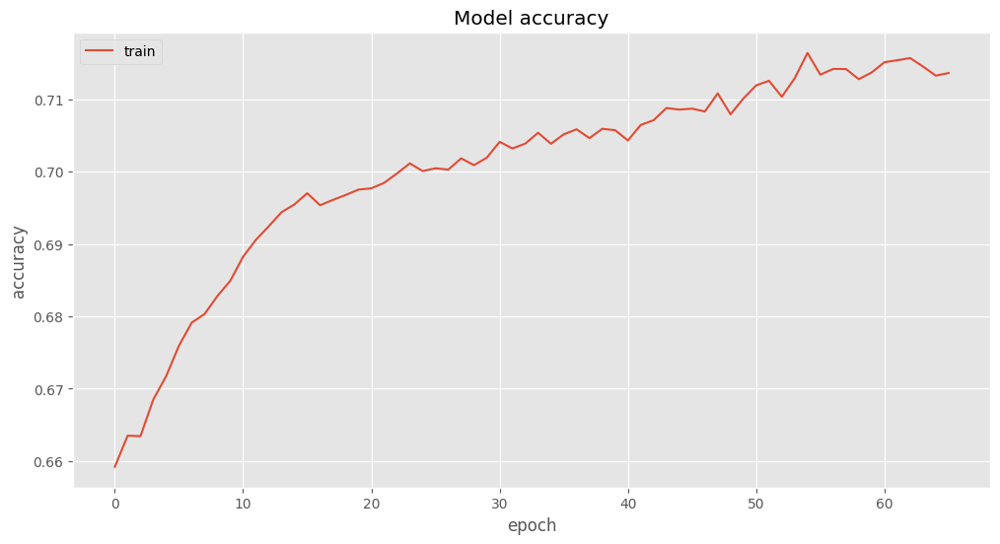

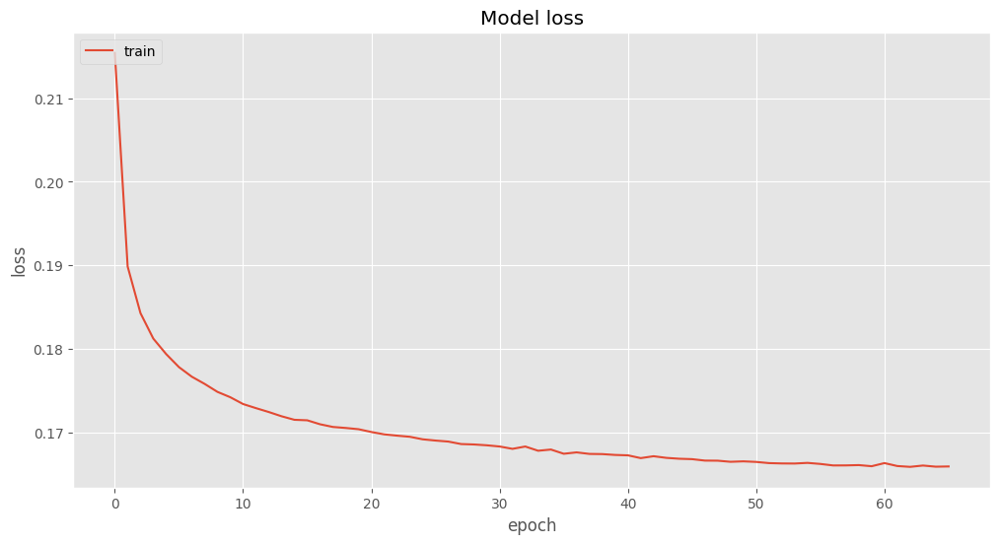

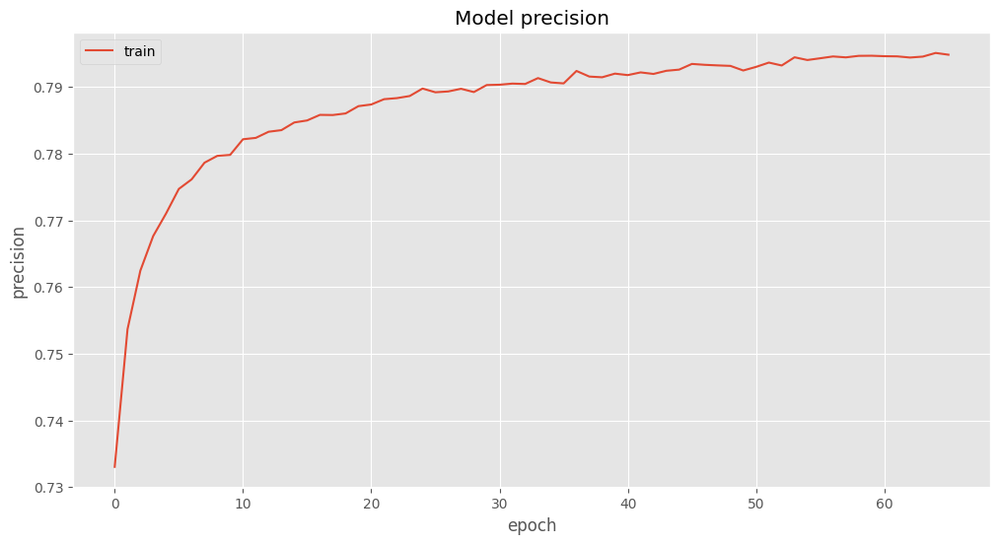

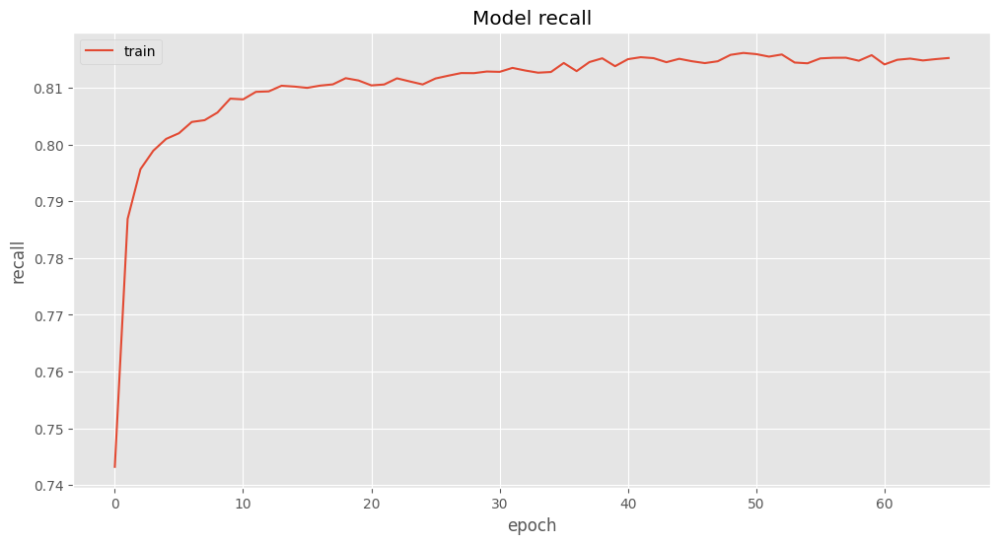

In [25]:

# summarize history for accuracy
plt.plot(history['accuracy'])
plt.title('Model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history['loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(history['precision_16'])
plt.title('Model precision')
plt.ylabel('precision')
plt.xlabel('epoch')
plt.legend(['train'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(history['recall_16'])
plt.title('Model recall')
plt.ylabel('recall')
plt.xlabel('epoch')
plt.legend(['train'], loc='upper left')
plt.show()

# Adding additional features

In [ ]:
!pip install biopython

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 37.8 MB/s eta 0:00:00


Extracting all pdb ids present in our dataset:

In [ ]:
pdb_ids_list = list(np.unique(np.array([str(value) for value in df['pdb_id'].values])))

In [ ]:
from Bio.PDB import PDBList, is_aa, PDBIO
from Bio.PDB.PDBParser import PDBParser
from Bio.SeqUtils import IUPACData
from Bio.PDB.PDBIO import Select
from Bio.SeqIO.PdbIO import PdbSeqresIterator

Creating dictionary structure for each protein (pdb_id) and as a value ProteinAnalysis object for the respected protein.

In [ ]:
from Bio import PDB
from Bio.SeqUtils.ProtParam import ProteinAnalysis
import pandas as pd

sequences_dict = {}

for pdb_id in pdb_ids_list:
  # PDB ID of the protein structure
  # pdb_id = '1xyz'

  pdbl = PDBList()
  pdbl.retrieve_pdb_file(pdb_id, pdir=path + "/pdb", file_format='pdb')  # Will save a pdbXXXX.ent file

  # Create a PDBParser object
  pdb_parser = PDB.PDBParser()

  # Retrieve the structure from the PDB
  structure = pdb_parser.get_structure(pdb_id, path + "/pdb/pdb{}.ent".format(pdb_id))

  # Get the first model in the structure
  model = structure[0]

  # Get the sequence of the structure
  sequence = ''
  for chain in model:
      polypeptides = PDB.PPBuilder().build_peptides(chain)
      for polypeptide in polypeptides:
          sequence += polypeptide.get_sequence()

  sequences_dict[pdb_id] = ProteinAnalysis(sequence)





Inspecting filenames and observing that some pdb_id names are read as float numbers instead of string, and by that converted to a weird pdb_id entry not corresponding to the pdb_id itself at all. Therefore we decided to drop these pdb_ids in the dataset that we will use to calculate additional features.

In [ ]:
import os
import glob

directory = path + "/features_ring"  # Replace with the actual directory path

# Get the list of filenames in the directory
filenames = glob.glob(directory + "/*.tsv")
proteins_tsv = []

# Print the filenames
for filename in filenames:
    proteins_tsv.append(filename[-8:-4])

In [ ]:
filenames = glob.glob(directory)

# Print the filenames
for filename in filenames:
    print(filename)

In [ ]:
set(pdb_ids_list).difference(set(proteins_tsv))

{'1e+29', '50000000000000.0', '5e+75', '6e+60'}

In [ ]:
df[df['pdb_id'] == 1e+29]

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_down,t_phi,t_psi,t_ss3,t_a1,t_a2,t_a3,t_a4,t_a5,Interaction
0,99999999999999991433150857216.0,A,74,,E,H,0.438,12.0,15.0,-1.071,...,21.0,-1.498,-0.875,H,1.831,-0.561,0.533,-0.277,1.648,HBOND
1,99999999999999991433150857216.0,A,118,,Y,H,0.104,19.0,25.0,-0.906,...,12.0,-0.793,-0.837,H,-0.591,-1.302,-0.733,1.570,-0.146,HBOND
2,99999999999999991433150857216.0,A,90,,E,T,0.644,0.0,21.0,-1.932,...,5.0,-2.147,1.198,H,0.260,0.830,3.097,-0.838,1.512,NaN
3,99999999999999991433150857216.0,A,24,,R,H,0.839,1.0,17.0,-1.063,...,19.0,-1.020,-0.832,H,-0.032,0.326,2.213,0.908,1.313,HBOND
4,99999999999999991433150857216.0,A,116,,A,H,0.000,24.0,19.0,-1.076,...,23.0,-1.482,-0.347,H,-1.019,-0.987,-1.505,1.266,-0.912,HBOND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192,99999999999999991433150857216.0,A,33,,F,I,0.020,19.0,14.0,-1.002,...,8.0,-2.107,-0.422,H,-0.032,0.326,2.213,0.908,1.313,HBOND
193,99999999999999991433150857216.0,A,77,,K,H,0.234,11.0,21.0,-1.498,...,17.0,-2.842,2.858,H,0.945,0.828,1.299,-0.169,0.933,NaN
194,99999999999999991433150857216.0,A,5,,E,T,0.619,3.0,13.0,-1.075,...,22.0,-1.834,2.135,H,-0.032,0.326,2.213,0.908,1.313,NaN
195,99999999999999991433150857216.0,A,53,,S,S,0.031,19.0,15.0,-1.515,...,19.0,1.985,2.834,L,-0.384,1.652,1.330,1.045,2.064,HBOND


In [ ]:
df_filtered = df[(df['pdb_id'] != '7n50') & (df['pdb_id'] != 1e+29) & (df['pdb_id'] != 50000000000000.0) & (df['pdb_id'] != 5e+75) & (df['pdb_id'] != 6e+60) ]



In [ ]:
df_filtered

,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,s_phi,...,t_down,t_phi,t_psi,t_ss3,t_a1,t_a2,t_a3,t_a4,t_a5,Interaction
0,6iyg,A,246,,S,H,0.000,26.0,18.0,-0.994,...,20.0,0.914,0.757,L,1.831,-0.561,0.533,-0.277,1.648,HBOND
2,6iyg,A,136,,W,B,0.013,15.0,22.0,-2.153,...,8.0,-1.199,-0.375,H,1.050,0.302,-3.656,-0.259,-3.242,HBOND
4,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,15.0,-1.381,-0.597,H,0.931,-0.179,-3.005,-0.503,-1.853,HBOND
5,6iyg,A,259,,K,H,0.000,17.0,23.0,-1.043,...,15.0,-1.381,-0.597,H,0.931,-0.179,-3.005,-0.503,-1.853,VDW
6,6iyg,A,49,,D,T,0.080,20.0,11.0,-1.293,...,14.0,-2.142,-0.184,H,0.260,0.830,3.097,-0.838,1.512,HBOND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122,6j2m,A,428,,G,H,0.000,20.0,13.0,-1.049,...,13.0,-1.254,-0.594,H,-0.384,1.652,1.330,1.045,2.064,HBOND
123,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,14.0,-2.565,2.755,H,-1.006,-0.590,1.891,-0.397,0.412,HBOND
124,6j2m,A,392,,V,E,0.000,25.0,10.0,-1.979,...,14.0,-2.565,2.755,H,-1.006,-0.590,1.891,-0.397,0.412,VDW
129,6j2m,A,427,,K,H,0.644,10.0,17.0,-1.034,...,13.0,-1.839,0.155,H,-0.663,-1.524,2.219,-1.005,1.212,HBOND


In the next cell, we calculate the distance in Angstrom between the C-alpha atoms (with respect to their coordinates) within each pair of source and target residues present in the sequence.

In [ ]:
import Bio.PDB
import numpy


distances_list = []
cnt = 0
pdb_id_prev = ""

for  row in df_filtered.itertuples():
  cnt += 1

  pdb_id = row.pdb_id
  s_chain_id = row.s_ch
  t_chain_id = row.t_ch



  if pdb_id_prev != pdb_id:
    structure = PDBParser(QUIET=True).get_structure(pdb_id, path + "/pdb/pdb" + str(pdb_id) + ".ent")
  s_selected_residues = [residue for residue in structure[0][s_chain_id] if residue.id[0] == " "]
  t_selected_residues = [residue for residue in structure[0][t_chain_id] if residue.id[0] == " "]


  s_residue = [res for res in s_selected_residues if res.id[1] == row.s_resi][0]
  t_residue = [res for res in t_selected_residues if res.id[1] == row.t_resi][0]

  distance = s_residue["CA"] - t_residue["CA"]

  distances_list.append(distance)

  if cnt % 40000 == 0:
    print(cnt)

  pdb_id_prev = pdb_id





40000
80000
120000
160000
200000
240000
280000
320000
360000
400000
440000


In [ ]:
len(distances_list)

451872

We add the calculated distances as separate column in the dataset.

In [ ]:
new_column = pd.Series(distances_list, name='Distance')

In [ ]:
df_filtered.insert(len(df_filtered.columns)-1, new_column.name, new_column)

In addition, we calculate three more per residue features for each source and target residues using BioPython. These features are: hydrophobicity, isoelectric point and aromaticity as boolean feature.

In [ ]:
from Bio import PDB
from Bio.SeqUtils.ProtParam import ProteinAnalysis
import pandas as pd

df2 = df_filtered.copy()

# 1. Residue Hydrophobicity
df2['s_residue_hydrophobicity'] = df2['s_resn'].apply(lambda x: ProteinAnalysis(x).gravy())
df2['t_residue_hydrophobicity'] = df2['t_resn'].apply(lambda x: ProteinAnalysis(x).gravy())


# 2. Residue Charge
df2['s_residue_isoelectric_point'] = df2['s_resn'].apply(lambda x: ProteinAnalysis(x).isoelectric_point())
df2['t_residue_isoelectric_point'] = df2['t_resn'].apply(lambda x: ProteinAnalysis(x).isoelectric_point())

# 3. Residue Aromaticity
aromatic_residues = ['F', 'W', 'Y', 'H']
df2['s_residue_aromatic'] = df2['s_resn'].apply(lambda x: x in aromatic_residues)
df2['t_residue_aromatic'] = df2['t_resn'].apply(lambda x: x in aromatic_residues)

# Print the updated dataset
print(df2)

    pdb_id s_ch  s_resi s_ins s_resn s_ss8  s_rsa  s_up  s_down  s_phi  ...  \
0     6iyg    A     246            S     H  0.000  26.0    18.0 -0.994  ...   
2     6iyg    A     136            W     B  0.013  15.0    22.0 -2.153  ...   
4     6iyg    A     259            K     H  0.000  17.0    23.0 -1.043  ...   
5     6iyg    A     259            K     H  0.000  17.0    23.0 -1.043  ...   
6     6iyg    A      49            D     T  0.080  20.0    11.0 -1.293  ...   
..     ...  ...     ...   ...    ...   ...    ...   ...     ...    ...  ...   
122   6j2m    A     428            G     H  0.000  20.0    13.0 -1.049  ...   
123   6j2m    A     392            V     E  0.000  25.0    10.0 -1.979  ...   
124   6j2m    A     392            V     E  0.000  25.0    10.0 -1.979  ...   
129   6j2m    A     427            K     H  0.644  10.0    17.0 -1.034  ...   
130   6j2m    A     427            K     H  0.644  10.0    17.0 -1.034  ...   

      t_a4   t_a5   Distance  Interaction  s_residu

Slight column reordering is performed:

In [ ]:
# Get the list of column names
columns = df2.columns.tolist()

# Define the column to be moved
column_to_move = 'Interaction'

# Remove the column from the list
columns.remove(column_to_move)

# Insert the column at the desired position
new_position = len(columns)  # Index location where the column should be moved
columns.insert(new_position, column_to_move)

# Reindex the DataFrame with the modified column order
df2 = df2[columns]

print(df2)









    pdb_id s_ch  s_resi s_ins s_resn s_ss8  s_rsa  s_up  s_down  s_phi  ...  \
0     6iyg    A     246            S     H  0.000  26.0    18.0 -0.994  ...   
2     6iyg    A     136            W     B  0.013  15.0    22.0 -2.153  ...   
4     6iyg    A     259            K     H  0.000  17.0    23.0 -1.043  ...   
5     6iyg    A     259            K     H  0.000  17.0    23.0 -1.043  ...   
6     6iyg    A      49            D     T  0.080  20.0    11.0 -1.293  ...   
..     ...  ...     ...   ...    ...   ...    ...   ...     ...    ...  ...   
122   6j2m    A     428            G     H  0.000  20.0    13.0 -1.049  ...   
123   6j2m    A     392            V     E  0.000  25.0    10.0 -1.979  ...   
124   6j2m    A     392            V     E  0.000  25.0    10.0 -1.979  ...   
129   6j2m    A     427            K     H  0.644  10.0    17.0 -1.034  ...   
130   6j2m    A     427            K     H  0.644  10.0    17.0 -1.034  ...   

      t_a4   t_a5   Distance  s_residue_hydrophobic

Finally, we save the dataset without missing values and with the 7 additional features we added in this section.

In [ ]:
df2.to_csv(path + "/clean_additional_features_dataset.csv")

In [ ]:
pd.read_csv(path + "/clean_additional_features_dataset.csv")

,Unnamed: 0,pdb_id,s_ch,s_resi,s_ins,s_resn,s_ss8,s_rsa,s_up,s_down,...,t_a4,t_a5,Distance,s_residue_hydrophobicity,t_residue_hydrophobicity,s_residue_isoelectric_point,t_residue_isoelectric_point,s_residue_aromatic,t_residue_aromatic,Interaction
0,0,6iyg,A,246,,S,H,0.000,26.0,18.0,...,-0.277,1.648,5.502789,-0.8,-3.9,5.240009,8.750052,False,False,HBOND
1,2,6iyg,A,136,,W,B,0.013,15.0,22.0,...,-0.259,-3.242,6.184382,-0.9,-3.5,5.525000,4.299381,True,False,HBOND
2,4,6iyg,A,259,,K,H,0.000,17.0,23.0,...,-0.503,-1.853,10.881779,-3.9,-3.5,8.750052,5.525000,False,False,HBOND
3,5,6iyg,A,259,,K,H,0.000,17.0,23.0,...,-0.503,-1.853,8.005460,-3.9,-3.5,8.750052,5.525000,False,False,VDW
4,6,6iyg,A,49,,D,T,0.080,20.0,11.0,...,-0.838,1.512,7.902977,-3.5,-1.3,4.299381,5.524318,False,True,HBOND
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
451867,122,6j2m,A,428,,G,H,0.000,20.0,13.0,...,1.045,2.064,7.908767,-0.4,-0.4,5.525000,5.525000,False,False,HBOND
451868,123,6j2m,A,392,,V,E,0.000,25.0,10.0,...,-0.397,0.412,5.203335,4.2,2.8,5.494989,5.525000,False,True,HBOND
451869,124,6j2m,A,392,,V,E,0.000,25.0,10.0,...,-0.397,0.412,5.330440,4.2,2.8,5.494989,5.525000,False,True,VDW
451870,129,6j2m,A,427,,K,H,0.644,10.0,17.0,...,-1.005,1.212,5.946533,-3.9,1.9,8.750052,5.275022,False,False,HBOND
